<center><h1> Customer Segmentation </h1></center>

<a id="import"></a>
# 1️⃣ㅣImport Libraries

In [170]:
#Import libraries
#loading dataset
import pandas as pd
import numpy as np

#visualisation
import matplotlib.pyplot as plt
%matplotlib inline
import plotly.express as px
import seaborn as sns
from kneed import KneeLocator

# data modeling
from sklearn.cluster import KMeans
from scipy.cluster.hierarchy import ward,dendrogram,linkage
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import DBSCAN
from sklearn.cluster import AgglomerativeClustering
from sklearn.mixture import GaussianMixture

# Model performance
from sklearn.preprocessing import  StandardScaler
from sklearn import metrics
from sklearn.metrics import silhouette_score
from tqdm import tqdm
from sklearn.metrics import calinski_harabasz_score
from sklearn.metrics import davies_bouldin_score
from sklearn.decomposition import PCA

#warnings
import warnings
warnings.simplefilter(action='ignore')

<a id="data"></a>
# 2️⃣ㅣLoad data💾 

In [2]:
# reading data into dataframe
df=pd.read_csv(r'F:\Machine Learning\data\Customer_Data (1).csv')

df

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,C10001,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,C10002,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,C10003,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,C10005,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,C19186,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.500000,6
8946,C19187,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,275.861322,NaN,0.000000,6
8947,C19188,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.250000,6
8948,C19189,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.250000,6


In [3]:
df.shape

(8950, 18)

- CUST_ID: Credit card holder ID
- BALANCE: Monthly average balance (based on daily balance averages)
- BALANCE_FREQUENCY: Ratio of last 12 months with balance.How frequently the Balance is updated, score between 0 and 1 (1 = frequently updated, 0 = not frequently updated)
- PURCHASES: Total purchase amount spent during last 12 months
- ONEOFF_PURCHASES: Total amount of one-off purchases
- INSTALLMENTS_PURCHASES: Total amount of installment purchases
- CASH_ADVANCE: Total cash-advance amount
- PURCHASES_ FREQUENCY: Frequency of purchases (Percent of months with at least one purchase).How frequently the Purchases are being made score between 0 and 1 (1 = frequently purchased, 0 = not frequently purchased)
- ONEOFF_PURCHASES_FREQUENCY: Frequency of one-off-purchases.How frequently Purchases are happening in one-go (1 = frequently purchased, 0 = not frequently purchased) 
- PURCHASES_INSTALLMENTS_FREQUENCY: Frequency of installment purchases.How frequently purchases in installments are being done (1 = frequently done, 0 = not frequently done)
- CASH_ADVANCE_ FREQUENCY: Cash-Advance frequency
- AVERAGE_PURCHASE_TRX: Average amount per purchase transaction
- CASH_ADVANCE_TRX: Average amount per cash-advance transaction
- PURCHASES_TRX: Average amount per purchase transaction
- CREDIT_LIMIT: Credit limit
- PAYMENTS: Total payments (due amount paid by the customer to decrease their statement balance) in the period
- MINIMUM_PAYMENTS: Total minimum payments due in the period.
- PRC_FULL_PAYMEN: Percentage of months with full payment of the due statement balance
- TENURE: Number of months as a customer

In [4]:
# lists name of columns
df.columns

Index(['CUST_ID', 'BALANCE', 'BALANCE_FREQUENCY', 'PURCHASES',
       'ONEOFF_PURCHASES', 'INSTALLMENTS_PURCHASES', 'CASH_ADVANCE',
       'PURCHASES_FREQUENCY', 'ONEOFF_PURCHASES_FREQUENCY',
       'PURCHASES_INSTALLMENTS_FREQUENCY', 'CASH_ADVANCE_FREQUENCY',
       'CASH_ADVANCE_TRX', 'PURCHASES_TRX', 'CREDIT_LIMIT', 'PAYMENTS',
       'MINIMUM_PAYMENTS', 'PRC_FULL_PAYMENT', 'TENURE'],
      dtype='object')

### <a id="eda"></a>
# 3️⃣ ㅣData Preprocessing

In [5]:
#to view some basic statistical details of train data
df.describe()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
count,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8949.000000,8950.000000,8637.000000,8950.000000,8950.000000
mean,1564.474828,0.877271,1003.204834,592.437371,411.067645,978.871112,0.490351,0.202458,0.364437,0.135144,3.248827,14.709832,4494.449450,1733.143852,864.206542,0.153715,11.517318
std,2081.531879,0.236904,2136.634782,1659.887917,904.338115,2097.163877,0.401371,0.298336,0.397448,0.200121,6.824647,24.857649,3638.815725,2895.063757,2372.446607,0.292499,1.338331
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.000000,0.000000,0.019163,0.000000,6.000000
25%,128.281915,0.888889,39.635000,0.000000,0.000000,0.000000,0.083333,0.000000,0.000000,0.000000,0.000000,1.000000,1600.000000,383.276166,169.123707,0.000000,12.000000
50%,873.385231,1.000000,361.280000,38.000000,89.000000,0.000000,0.500000,0.083333,0.166667,0.000000,0.000000,7.000000,3000.000000,856.901546,312.343947,0.000000,12.000000
75%,2054.140036,1.000000,1110.130000,577.405000,468.637500,1113.821139,0.916667,0.300000,0.750000,0.222222,4.000000,17.000000,6500.000000,1901.134317,825.485459,0.142857,12.000000
max,19043.138560,1.000000,49039.570000,40761.250000,22500.000000,47137.211760,1.000000,1.000000,1.000000,1.500000,123.000000,358.000000,30000.000000,50721.483360,76406.207520,1.000000,12.000000


In [6]:
# checking the number of rows and columns in train dataset
rows,col=df.shape
print ('Row:' , rows,'\nColumns:',col)

Row: 8950 
Columns: 18


In [7]:
#getting some information about the datafram
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8950 entries, 0 to 8949
Data columns (total 18 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   CUST_ID                           8950 non-null   object 
 1   BALANCE                           8950 non-null   float64
 2   BALANCE_FREQUENCY                 8950 non-null   float64
 3   PURCHASES                         8950 non-null   float64
 4   ONEOFF_PURCHASES                  8950 non-null   float64
 5   INSTALLMENTS_PURCHASES            8950 non-null   float64
 6   CASH_ADVANCE                      8950 non-null   float64
 7   PURCHASES_FREQUENCY               8950 non-null   float64
 8   ONEOFF_PURCHASES_FREQUENCY        8950 non-null   float64
 9   PURCHASES_INSTALLMENTS_FREQUENCY  8950 non-null   float64
 10  CASH_ADVANCE_FREQUENCY            8950 non-null   float64
 11  CASH_ADVANCE_TRX                  8950 non-null   int64  
 12  PURCHA

In [8]:
## printing total numbers of Unique value in the dataframe. 
df.nunique()

CUST_ID                             8950
BALANCE                             8871
BALANCE_FREQUENCY                     43
PURCHASES                           6203
ONEOFF_PURCHASES                    4014
INSTALLMENTS_PURCHASES              4452
CASH_ADVANCE                        4323
PURCHASES_FREQUENCY                   47
ONEOFF_PURCHASES_FREQUENCY            47
PURCHASES_INSTALLMENTS_FREQUENCY      47
CASH_ADVANCE_FREQUENCY                54
CASH_ADVANCE_TRX                      65
PURCHASES_TRX                        173
CREDIT_LIMIT                         205
PAYMENTS                            8711
MINIMUM_PAYMENTS                    8636
PRC_FULL_PAYMENT                      47
TENURE                                 7
dtype: int64

In [9]:
# Find the total number of missing values in the dataframe
df.isnull().sum()

CUST_ID                               0
BALANCE                               0
BALANCE_FREQUENCY                     0
PURCHASES                             0
ONEOFF_PURCHASES                      0
INSTALLMENTS_PURCHASES                0
CASH_ADVANCE                          0
PURCHASES_FREQUENCY                   0
ONEOFF_PURCHASES_FREQUENCY            0
PURCHASES_INSTALLMENTS_FREQUENCY      0
CASH_ADVANCE_FREQUENCY                0
CASH_ADVANCE_TRX                      0
PURCHASES_TRX                         0
CREDIT_LIMIT                          1
PAYMENTS                              0
MINIMUM_PAYMENTS                    313
PRC_FULL_PAYMENT                      0
TENURE                                0
dtype: int64

- we can see we have 1 null value in CREDIT_LIMIT and 313 in MINIMUM_PAYMENTS

In [10]:
missing_count=df.isnull().sum() #the count of missing values
value_count= df.isnull().count()#the count of all values
missing_percentage= round(missing_count/value_count*100,2)#the percentage of missing values
missing_df= pd.DataFrame({'count': missing_count,'percentage':missing_percentage })#create a dataframe
print(missing_df)

                                  count  percentage
CUST_ID                               0        0.00
BALANCE                               0        0.00
BALANCE_FREQUENCY                     0        0.00
PURCHASES                             0        0.00
ONEOFF_PURCHASES                      0        0.00
INSTALLMENTS_PURCHASES                0        0.00
CASH_ADVANCE                          0        0.00
PURCHASES_FREQUENCY                   0        0.00
ONEOFF_PURCHASES_FREQUENCY            0        0.00
PURCHASES_INSTALLMENTS_FREQUENCY      0        0.00
CASH_ADVANCE_FREQUENCY                0        0.00
CASH_ADVANCE_TRX                      0        0.00
PURCHASES_TRX                         0        0.00
CREDIT_LIMIT                          1        0.01
PAYMENTS                              0        0.00
MINIMUM_PAYMENTS                    313        3.50
PRC_FULL_PAYMENT                      0        0.00
TENURE                                0        0.00


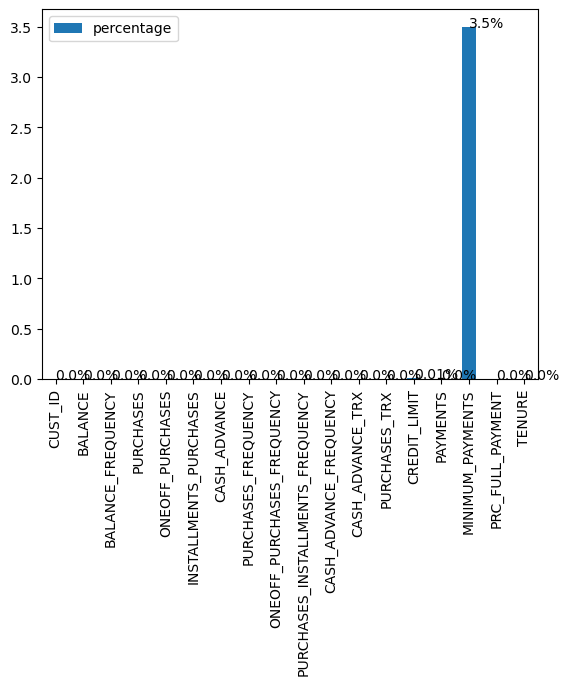

In [11]:
barchart=missing_df.plot.bar(y= 'percentage')
for index, percentage in enumerate(missing_percentage):
    barchart.text(index,percentage, str(percentage)+"%")

In [12]:

# checking the value which is Null for Credit Limit
df[df['CREDIT_LIMIT'].isnull()]

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
5203,C15349,18.400472,0.166667,0.0,0.0,0.0,186.853063,0.0,0.0,0.0,0.166667,1,0,NaN,9.040017,14.418723,0.0,6


In [13]:
# dropping off the missing value for Credit Limit

df = df.drop(5203)
# resetting the index after dropping the record:
df = df.reset_index(drop=True)

In [14]:
df[['PAYMENTS', 'MINIMUM_PAYMENTS']][df['MINIMUM_PAYMENTS'].isna()]

,PAYMENTS,MINIMUM_PAYMENTS
3,0.000000,NaN
45,0.000000,NaN
47,0.000000,NaN
54,417.016763,NaN
55,0.000000,NaN
...,...,...
8918,0.000000,NaN
8928,0.000000,NaN
8934,0.000000,NaN
8943,0.000000,NaN


- It is pretty obvious that customers who haven't done any payments wouldn't have minimum payments also
- Hence, if PAYMENTS = 0, MINIMUM_PAYMENTS = 0

In [15]:
# Looking at PAYMENTS that's above MINIMUM_PAYMENTS

print('Shape:', df[['PAYMENTS', 'MINIMUM_PAYMENTS']][(df['MINIMUM_PAYMENTS'].notna()) & (df['PAYMENTS'] > df['MINIMUM_PAYMENTS'])].shape)
df[['PAYMENTS', 'MINIMUM_PAYMENTS']][(df['MINIMUM_PAYMENTS'].notna()) & (df['PAYMENTS'] > df['MINIMUM_PAYMENTS'])].head()

Shape: (6272, 2)


,PAYMENTS,MINIMUM_PAYMENTS
0,201.802084,139.509787
1,4103.032597,1072.340217
4,678.334763,244.791237
6,6354.314328,198.065894
7,679.065082,532.033990


In [16]:
# Looking at PAYMENTS that's below MINIMUM_PAYMENTS

print('Shape:', df[['PAYMENTS', 'MINIMUM_PAYMENTS']][(df['MINIMUM_PAYMENTS'].notna()) & (df['PAYMENTS'] < df['MINIMUM_PAYMENTS'])].shape)
df[['PAYMENTS', 'MINIMUM_PAYMENTS']][(df['MINIMUM_PAYMENTS'].notna()) & (df['PAYMENTS'] < df['MINIMUM_PAYMENTS'])].head()

Shape: (2364, 2)


,PAYMENTS,MINIMUM_PAYMENTS
2,622.066742,627.284787
5,1400.057770,2407.246035
10,1083.301007,2172.697765
14,805.647974,989.962866
15,1993.439277,2109.906490


- Logically, payments should be done if PAYMENTS above MINIMUM_PAYMENTS. Which is true for 6272 customers.
- But on the other hand, we got 2364 customers who did the PAYMENTS below MINIMUM_PAYMENTS which lead to invalid values. But we would like to leave it that way.
- Hence, we fill the missing values by the mean of PAYMENTS
- if PAYMENTS is less than MINIMUM_PAYMENTS, the missing values will be filled by the correspond PAYMENTS

In [17]:
minpay = df['MINIMUM_PAYMENTS'].copy() # make a copy of MINIMUM_PAYMENTS
payments_mean = np.mean(df['PAYMENTS']) # take the mean value of PAYMENTS

i = 0
for payments, minpayments in zip(df['PAYMENTS'], df['MINIMUM_PAYMENTS'].isna()):
    if (payments == 0) and (minpayments == True):
        minpay[i] = 0
    elif (0 < payments < payments_mean) and (minpayments == True): 
        minpay[i] = payments
    elif minpayments == True: 

        minpay[i] = payments_mean
    i += 1
    
df['MINIMUM_PAYMENTS'] = minpay.copy()


In [18]:
# Now again check the missing values.

df.isnull().any()

CUST_ID                             False
BALANCE                             False
BALANCE_FREQUENCY                   False
PURCHASES                           False
ONEOFF_PURCHASES                    False
INSTALLMENTS_PURCHASES              False
CASH_ADVANCE                        False
PURCHASES_FREQUENCY                 False
ONEOFF_PURCHASES_FREQUENCY          False
PURCHASES_INSTALLMENTS_FREQUENCY    False
CASH_ADVANCE_FREQUENCY              False
CASH_ADVANCE_TRX                    False
PURCHASES_TRX                       False
CREDIT_LIMIT                        False
PAYMENTS                            False
MINIMUM_PAYMENTS                    False
PRC_FULL_PAYMENT                    False
TENURE                              False
dtype: bool

In [19]:
#lets see if we have any duplicated entries and the result shows that all entries are unique
df.duplicated().sum()

0

In [20]:
#drop the CUST_ID column which doesn't provide any info .
df.drop(columns='CUST_ID' , axis=1 , inplace=True)

In [21]:
print('Number of columns={}'.format(len(df.columns)))

Number of columns=17


#### Monthly_avg_purchase

In [22]:
df['Monthly_avg_purchase']=df['PURCHASES']/df['TENURE']

In [23]:
print(df['Monthly_avg_purchase'].head(),'\n ',
df['TENURE'].head(),'\n', df['PURCHASES'].head())

0      7.950000
1      0.000000
2     64.430833
3    124.916667
4      1.333333
Name: Monthly_avg_purchase, dtype: float64 
  0    12
1    12
2    12
3    12
4    12
Name: TENURE, dtype: int64 
 0      95.40
1       0.00
2     773.17
3    1499.00
4      16.00
Name: PURCHASES, dtype: float64


#### Monthly_cash_advance Amount

In [24]:
df['Monthly_cash_advance']=df['CASH_ADVANCE']/df['TENURE']

In [25]:
df[df['ONEOFF_PURCHASES']==0]['ONEOFF_PURCHASES'].count()

4301

### <a id="eda"></a>
# 4️⃣ㅣExploratory Data Analysis (EDA)📊

<AxesSubplot:>

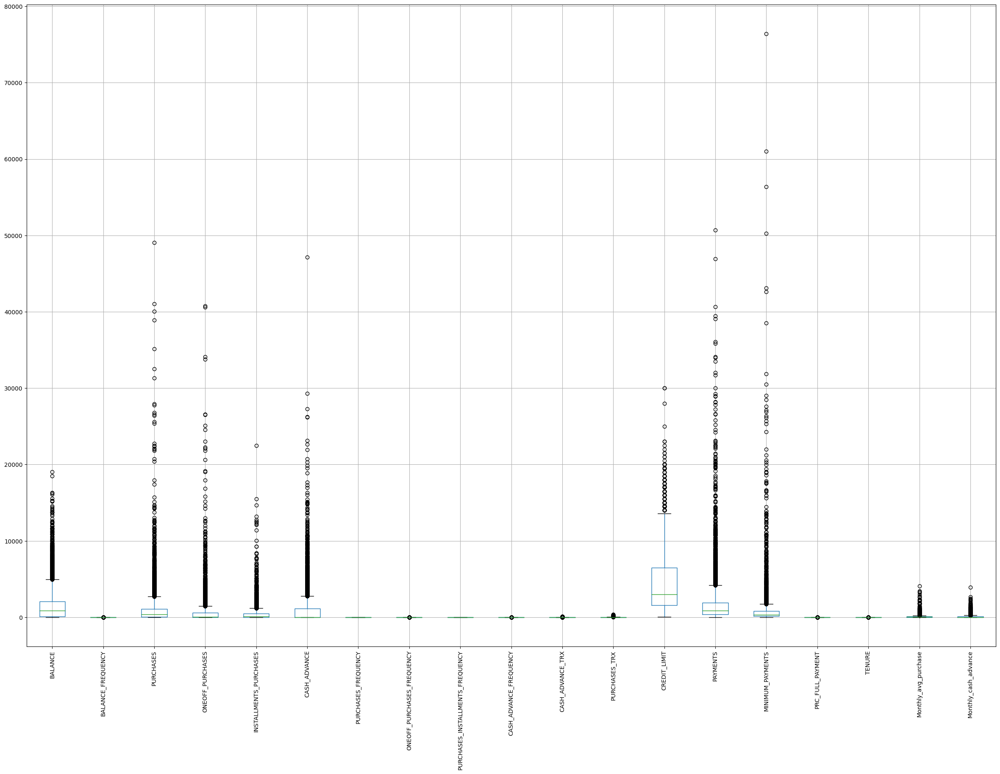

In [26]:
df.boxplot(rot=90 , figsize=(30,20))

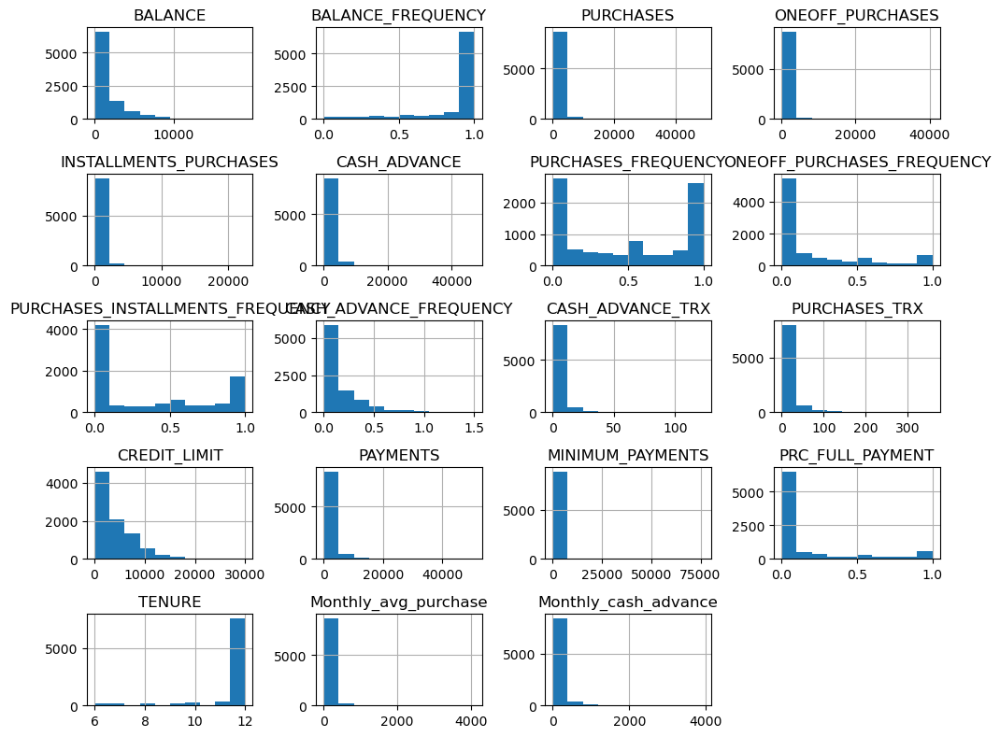

In [27]:
df.hist(figsize=(10,8))
plt.tight_layout()

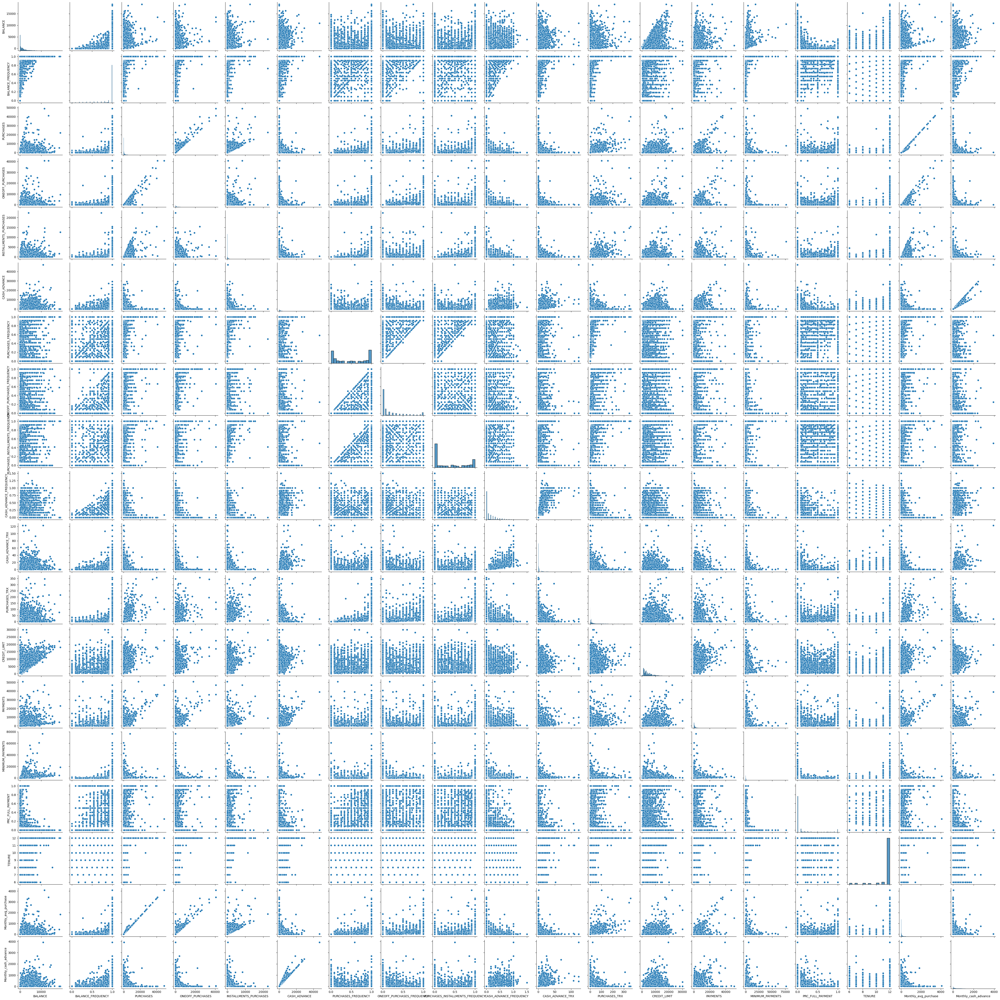

In [28]:
sns.pairplot(df)

Observation:
- 1- As the credit limit increase, the balance also increases hence a linear relationship
- 2- As the number of purchases increases, the number of "cash in advance" transactions decreases
- 3- As the credit balance is low, the purchases, oneoffpurchases and installments purchases are less. Thus validating our assumption from univariate analysis
- 4- Purchases, oneoffpurchases and installment purchases are all related linearly
- 5- As the credit balance is low, the "cash in advance" transactions are less

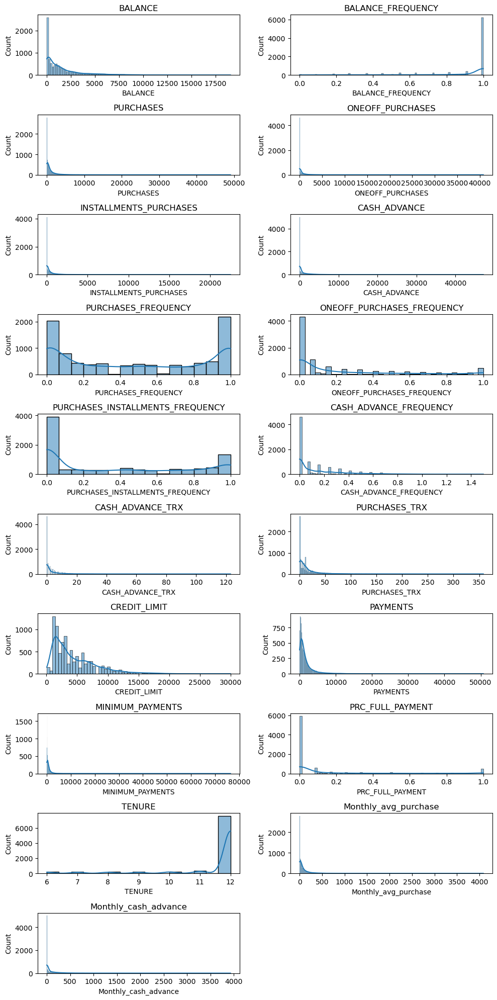

In [29]:
#we are going to use dist_plot which is a combination of "hist" function in matplotlib and "KDE" in seaborn
palette_color=sns.color_palette('bright')
plt.figure(figsize=(10,20))
for i in range (len(df.columns)):
    plt.subplot(10,2,i+1)
    sns.histplot(df[df.columns[i]] ,kde=True)
    plt.title(df.columns[i])
    plt.tight_layout()

Observation:
- 1- Most credit card holders have low credit limit and maintain credit balance below 7500
- 2- Variable such as Purchases, OneOffPurchases, installmentpurchases and cash advances also follow the same trend as     credit balance. They could all be related. That is as the credit balance is low, the purchases are also low and so on
- 3- Most people either don't purchase anything or they purchase very frequently
- 4- People who purchase in installments is more than people who purchase in one-go
- 5- In the last 6 months, most people have made total payments below 10000, with the minimum payments below 5000
- 6- Finally, most of the credit card holders own a card for more than 12 months

<a id="modeling"></a>
# 5️⃣ ㅣCorrelation

<AxesSubplot:>

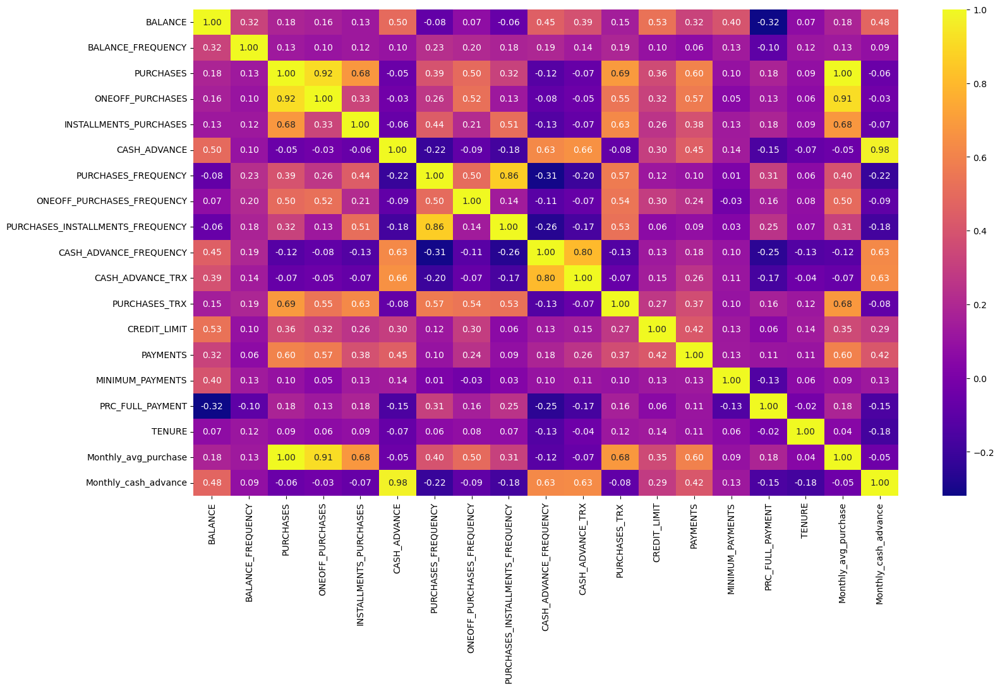

In [30]:
plt.figure(figsize = (18,10))
sns.heatmap(df.corr(), cmap= 'plasma',annot = True , fmt='.2f' )

Balance has a higher level of correlation with Cash Advance, Cash Advance Frequency and Credit Limit. Payments variable has a high correletion with Purchases and one off Purchases. Tenure has a negative correlation with Cash Advance and Cash Advance Frequency variables.
"PURACHASES_INSTALLMENTS_FREQUENCY" has strong positive correlation with "PURCHASE FREQUENCY",
            "BALANCE" has a strong negative correlation with "PRC_FULL_PAYMENT",
            "TENURE" has almost no correlation with any (No linear relationship)

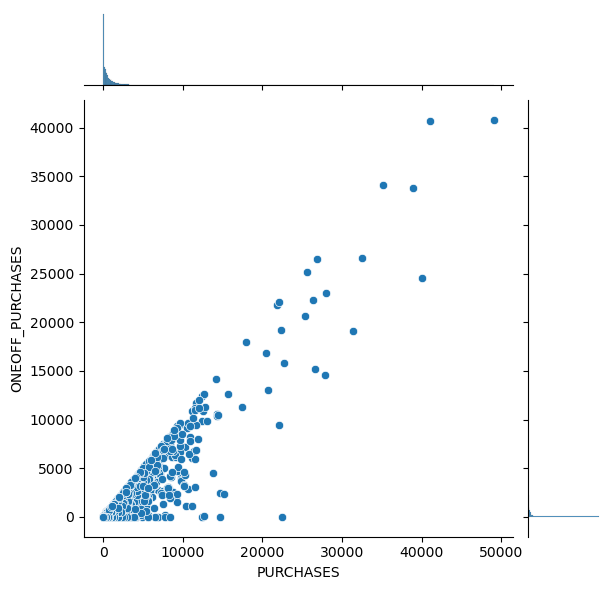

In [31]:
sns.jointplot(x='PURCHASES' , y='ONEOFF_PURCHASES', data=df)
plt.show()

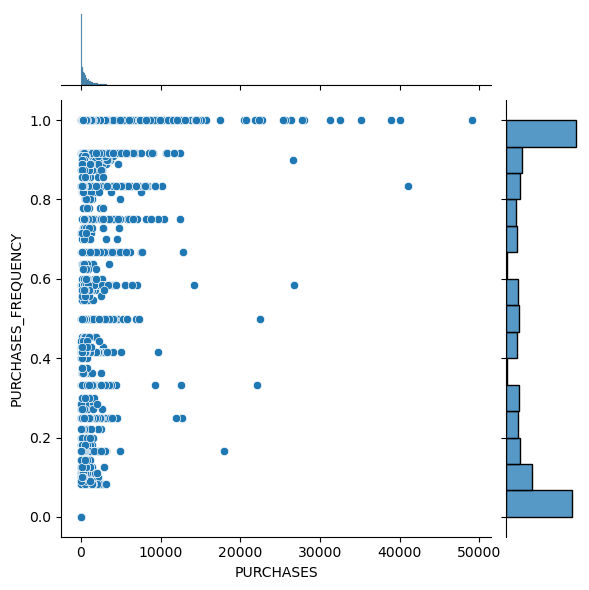

In [32]:
sns.jointplot(x='PURCHASES', y='PURCHASES_FREQUENCY', data=df)

Customers with more range of frequency have higher amount of purchases

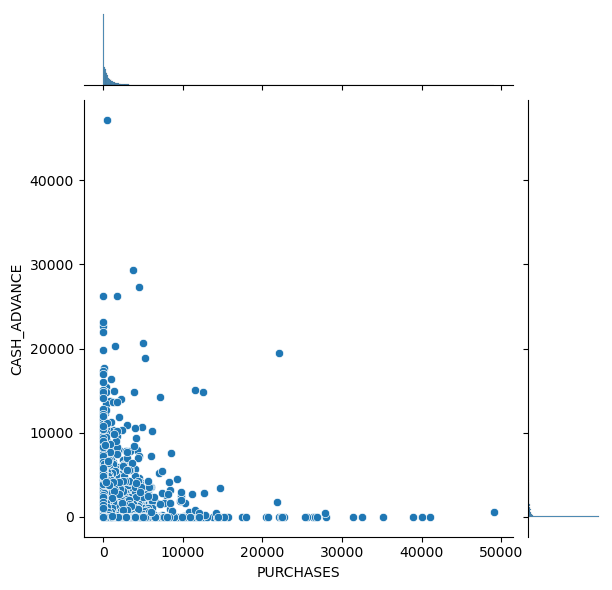

In [33]:
sns.jointplot(x='PURCHASES', y='CASH_ADVANCE', data=df)

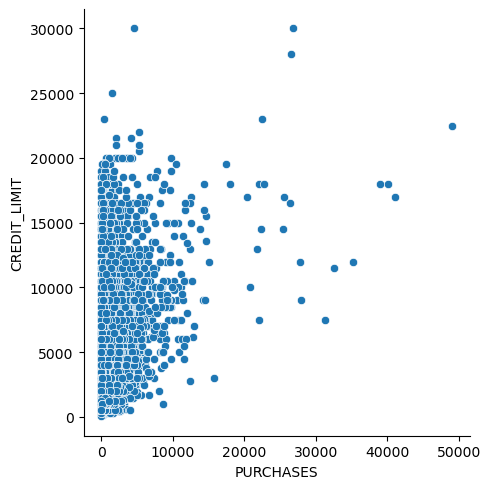

In [34]:
sns.relplot(x='PURCHASES',y='CREDIT_LIMIT',data=df)

- high purchases in the range 0-10000
- Credit limit more in the range 0-20000

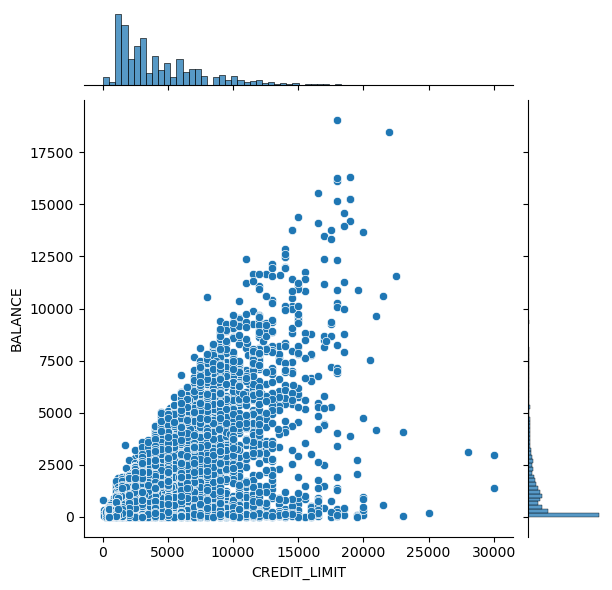

In [35]:
sns.jointplot(x='CREDIT_LIMIT', y='BALANCE', data=df)

- CREDIT_LIMIT & BALANCE are in a linear relation with each other ie. if a customer's balance increases, his/her credit limit shall increase
- Most customers lie in and under 15000 credit limit and 10K balance
others can be considered as premium customers

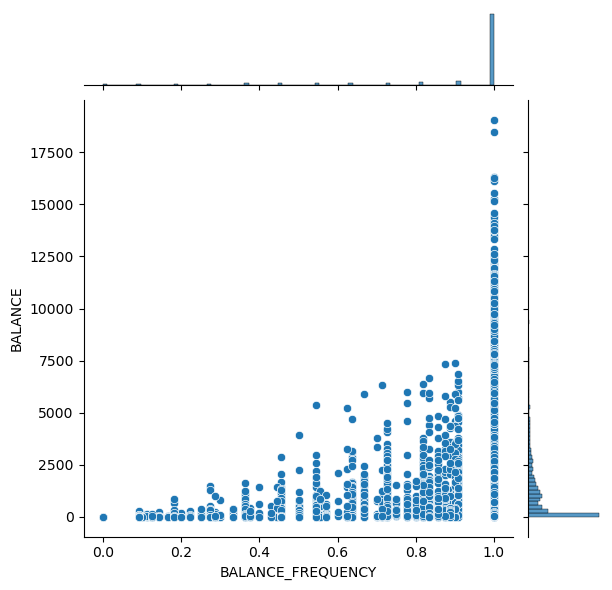

In [36]:
sns.jointplot(x='BALANCE_FREQUENCY', y='BALANCE', data=df)

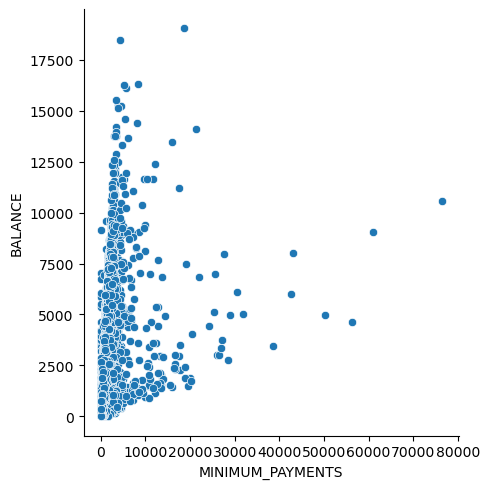

In [37]:
sns.relplot(x='MINIMUM_PAYMENTS',y='BALANCE',data=df)

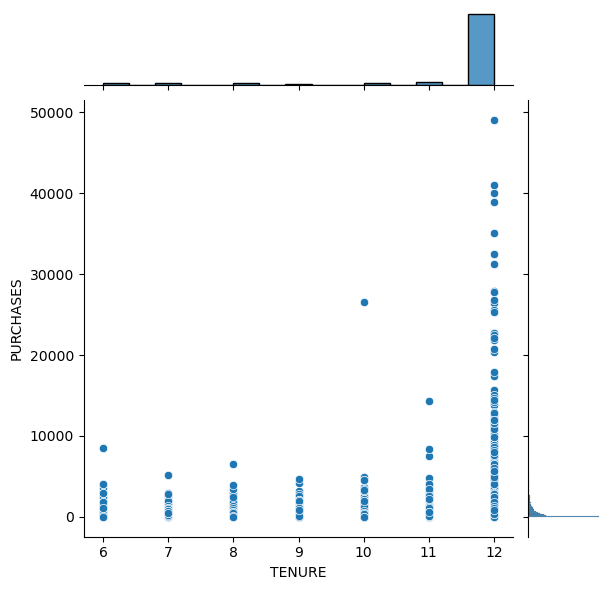

In [38]:
sns.jointplot(x='TENURE', y='PURCHASES', data=df)

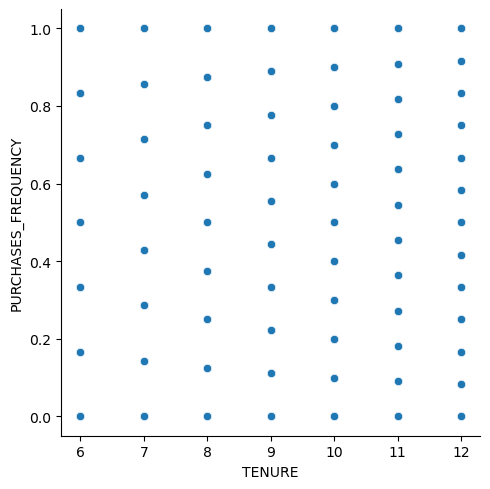

In [39]:
sns.relplot(x='TENURE',y='PURCHASES_FREQUENCY',data=df)

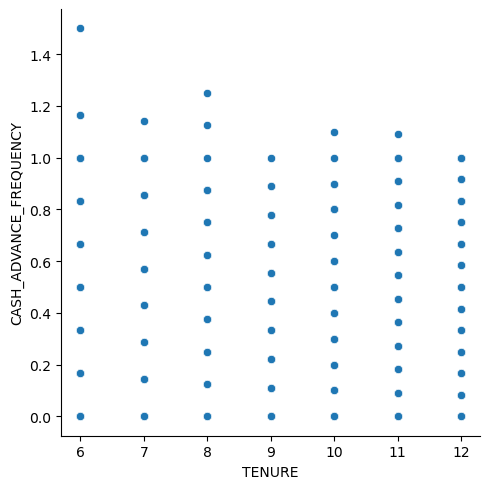

In [40]:
sns.relplot(x='TENURE',y='CASH_ADVANCE_FREQUENCY',data=df)

- Old customers(with tenure=12) have cash adv freq less than one
- New customers(tenure 6-11) take cash advance more frequently


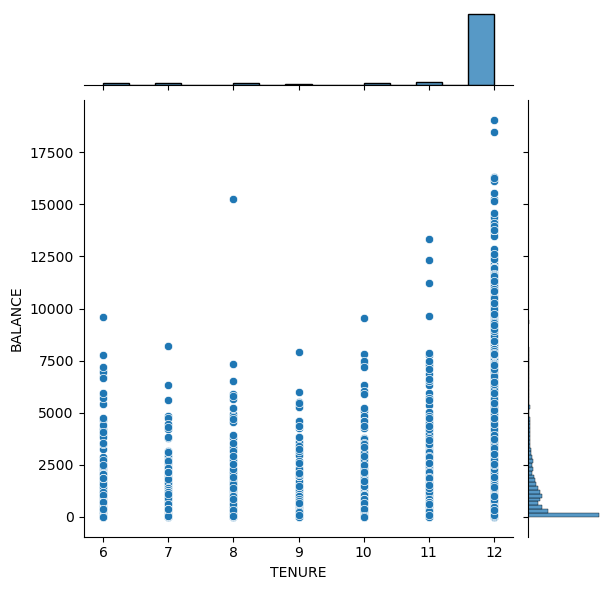

In [41]:
sns.jointplot(x='TENURE', y='BALANCE', data=df)

People with 12 as tenure tend to have more balance in their account - Customer Loyalty

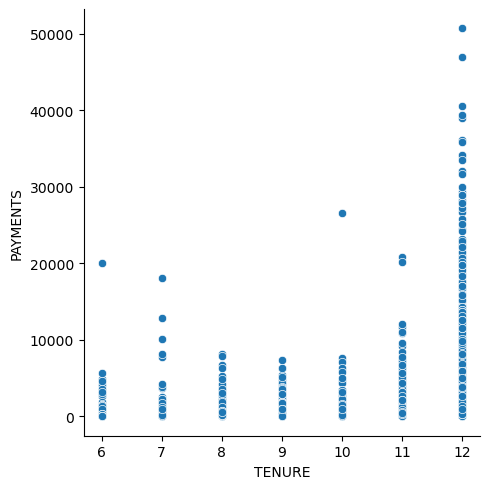

In [42]:
sns.relplot(x='TENURE',y='PAYMENTS',data=df)

more tenure more payment

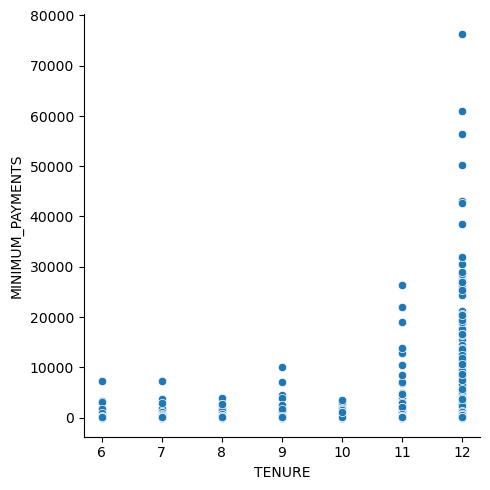

In [43]:
sns.relplot(x='TENURE',y='MINIMUM_PAYMENTS',data=df)

 More the tenure more is minimum payment

In [44]:
plt.figure(figsize=(10,5))
px.scatter(df, x='TENURE', y='CREDIT_LIMIT', color='TENURE')

<Figure size 1000x500 with 0 Axes>

With increase in TENURE, CREDIT_LIMIT increases

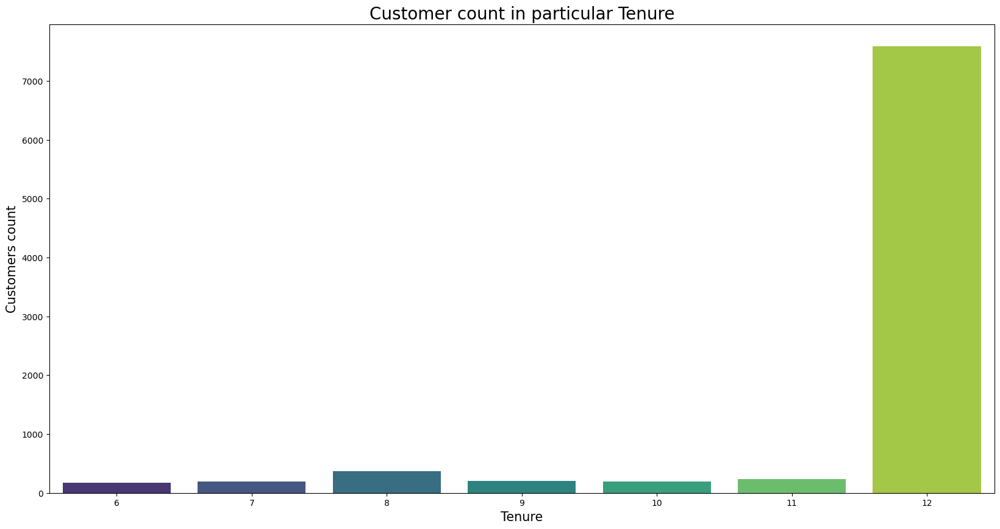

In [45]:
plt.figure(figsize = (20,10))
sns.barplot(x = df['TENURE'].unique(),
            y = df['TENURE'].value_counts(dropna = False),
            palette = "viridis")
plt.xlabel('Tenure',fontsize=15)
plt.ylabel('Customers count',fontsize=15)
plt.title('Customer count in particular Tenure',fontsize=20)
plt.show()

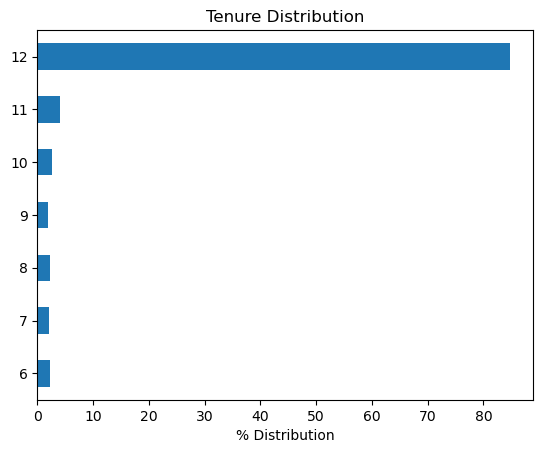

In [46]:
(1e2*df['TENURE'].value_counts().sort_index()/len(df)).plot(kind='barh')
plt.title('Tenure Distribution')
plt.xlabel('% Distribution');

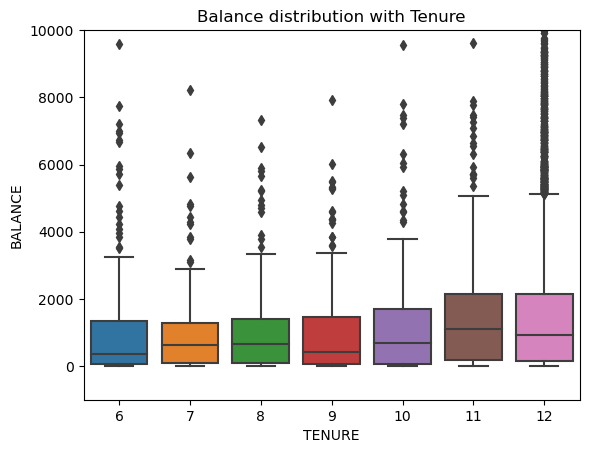

In [47]:
sns.boxplot(x="TENURE", y="BALANCE", data=df)
plt.ylim(-10**3, 10**4)
plt.title('Balance distribution with Tenure');

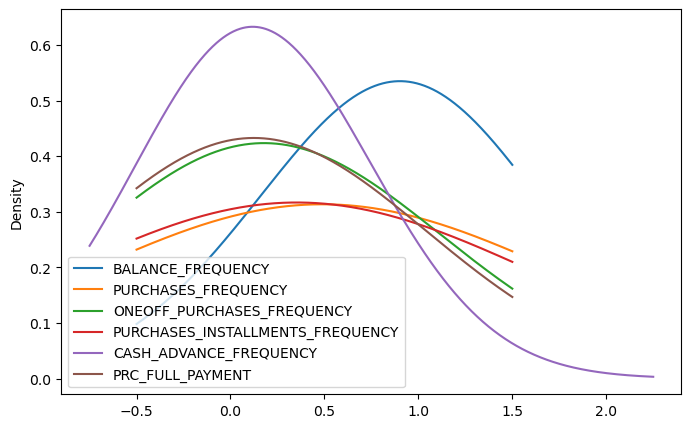

In [48]:
ax = df[['BALANCE_FREQUENCY', 'PURCHASES_FREQUENCY',
         'ONEOFF_PURCHASES_FREQUENCY', 'PURCHASES_INSTALLMENTS_FREQUENCY',
         'CASH_ADVANCE_FREQUENCY','PRC_FULL_PAYMENT']].plot.kde(figsize=(8,5), bw_method=3) #,ind=[0, 2, 3,4]

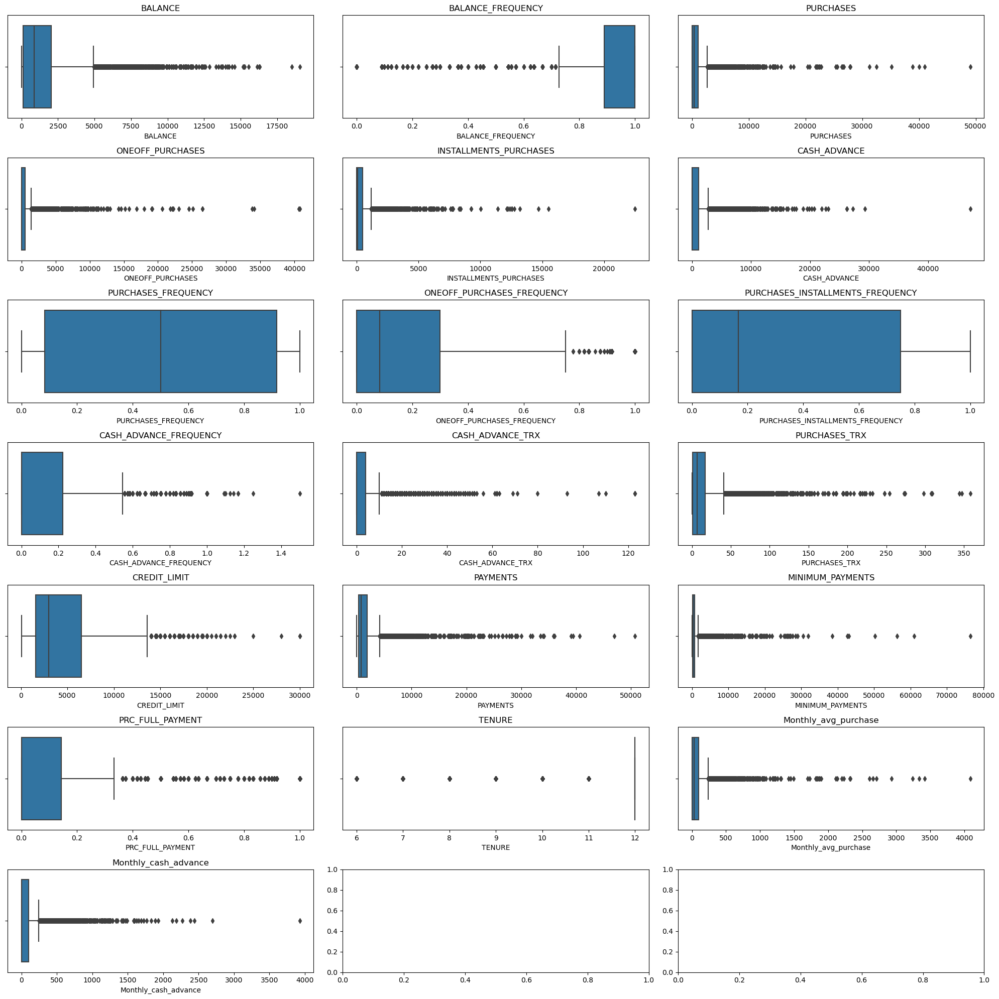

In [49]:
fig= plt.subplots(nrows=7 , ncols=3 , figsize=(20,20))
for i in range (len(df.columns)):
    plt.subplot(7,3,i+1)
    ax=  sns.boxplot(df[df.columns[i]])
    plt.title(df.columns[i])
    plt.tight_layout()

It looks like we have significant problem with outliers.

 Outlier detection model selection
- distribution is not normal
- distribution is highly skewed
- we have huge outliers
Isolation Forest does not assume normal distribution and is able to detect outliers at a multi-dimensional level. Isolation Forest is also computationally efficient. The algorithm is based on the principle that anomalies are observations that are few and different, this should make them easier to identify. That's why I choose Isolation Forest.

####  Isolation Forest

Isolation Forest(IF) is similar to Random Forest and it is build based on decision trees. There are no pre-defined labels here. It's an unsupervised learning algorithm that identifies anomaly by isolating outliers in the data.

The Isolation Forest (iForest) algorithm was initially proposed by Fei Tony Liu, Kai Ming Ting and Zhi-Hua Zhou in 2008. The authors took advantage of two quantitative properties of anomalous data points in a sample:

 - 1- Few - they are the minority consisting of fewer instances and
 - 2- Different - they have attribute-values that are very different from those of normal instances
Since the Isolation Forest algorithm is based on the principle that anomalies are observations that are few and different, this should make them easier to identify.

Isolation Forest does not assume normal distribution and is able to detect outliers at a multi-dimensional level. Isolation Forest is computationally efficient: the algorithm has a linear time complexity with a low constant and a low memory requirement. Therefore, it scales well to large data sets.

- https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.IsolationForest.html

In [50]:
from sklearn.ensemble import IsolationForest
df1 = df.copy()

In [51]:
# Model building
model=IsolationForest(n_estimators=150, max_samples='auto', contamination=float(0.1), max_features=1.0)
model.fit(df1)

IsolationForest(contamination=0.1, n_estimators=150)

In [52]:
# Adding 'scores' and 'anomaly' colums to df
scores=model.decision_function(df1)
anomaly=model.predict(df1)

df1['scores']=scores
df1['anomaly']=anomaly

anomaly = df1.loc[df1['anomaly']==-1]
anomaly_index = list(anomaly.index)
print('Total number of outliers is:', len(anomaly))

Total number of outliers is: 895


In [53]:
# dropping outliers
df1 = df1.drop(anomaly_index, axis = 0).reset_index(drop=True)

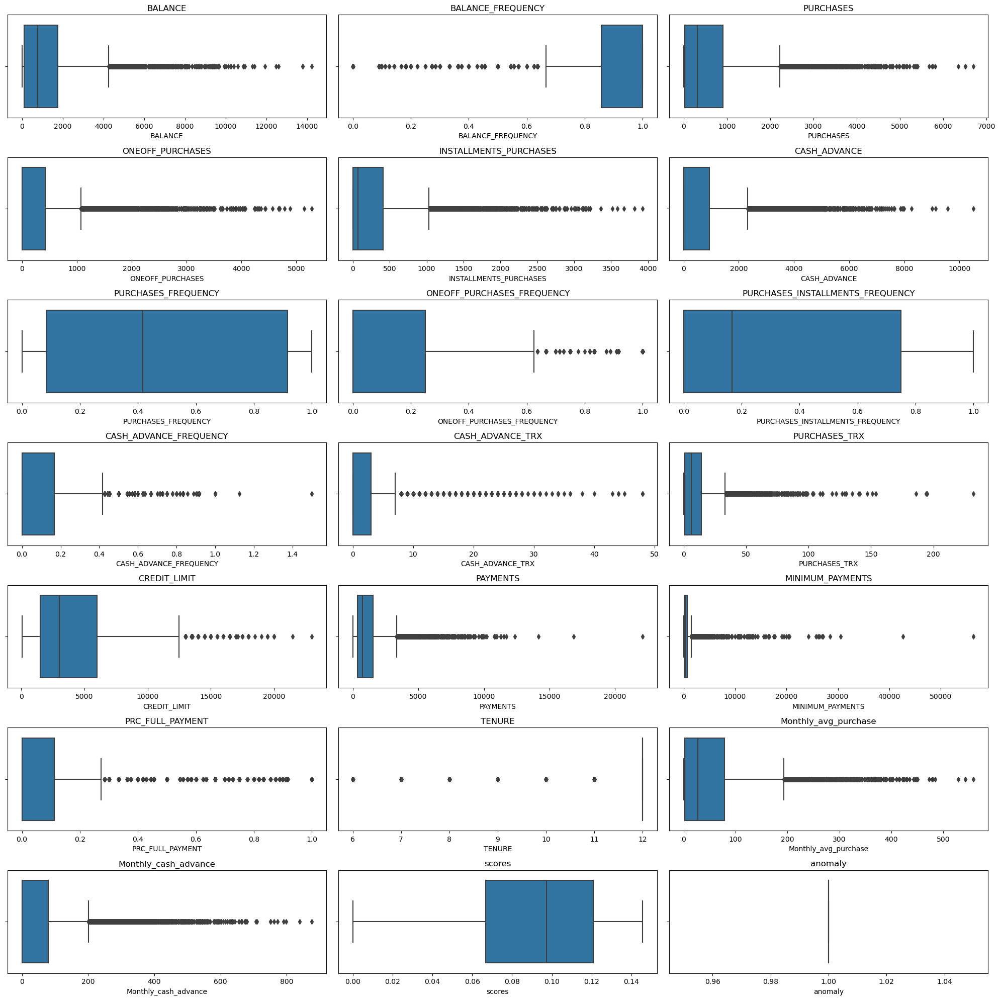

In [54]:
fig= plt.subplots(nrows=7 , ncols=3 , figsize=(20,20))
for i in range (len(df1.columns)):
    plt.subplot(7,3,i+1)
    ax=  sns.boxplot(df1[df1.columns[i]])
    plt.title(df1.columns[i])
    plt.tight_layout()

In [55]:
#drop the 'scores','anomaly' columns which doesn't provide any info .
df1.drop(columns='scores' , axis=1 , inplace=True)
df1.drop(columns='anomaly' , axis=1 , inplace=True)

<a id="summary"></a>
# 6️⃣ㅣ Model Building

#### 1.  Standardrizing data

In [56]:
scaler= StandardScaler()
scaled_features=scaler.fit_transform(df1)
scaled_df=pd.DataFrame(scaler.fit_transform(df1), columns = df1.columns)
scaled_df

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,Monthly_avg_purchase,Monthly_cash_advance
0,-0.757203,-0.216549,-0.631769,-0.539549,-0.418626,-0.552635,-0.757026,-0.634590,-0.676358,-0.673627,-0.549345,-0.585407,-0.961716,-0.724807,-0.319762,-0.508319,0.351760,-0.644964,-0.548933
1,1.138189,0.157399,-0.740325,-0.539549,-0.613849,4.576647,-1.176635,-0.634590,-0.889362,0.755345,0.320620,-0.712940,0.965260,2.089383,0.223220,0.287598,0.351760,-0.752037,4.194586
2,0.714144,0.531346,0.139467,0.649323,-0.613849,-0.552635,1.341012,3.067501,-0.889362,-0.673627,-0.549345,0.052254,1.125841,-0.421645,-0.035838,-0.508319,0.351760,0.115739,-0.548933
3,0.217463,-0.964443,0.965391,1.765401,-0.613849,-0.388806,-0.966832,-0.326083,-0.889362,-0.197305,-0.331854,-0.649174,1.125841,-0.870379,-0.400968,-0.508319,0.351760,0.930382,-0.397425
4,-0.291496,0.531346,-0.722118,-0.514946,-0.613849,-0.552635,-0.966832,-0.326083,-0.889362,-0.673627,-0.549345,-0.649174,-0.897483,-0.381056,-0.258480,-0.508319,0.351760,-0.734079,-0.548933
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8049,-0.665675,-0.154226,0.412063,1.017684,-0.613849,-0.552635,-0.337420,0.599439,-0.889362,-0.673627,-0.549345,-0.585407,0.001772,-0.870379,-0.400968,-0.508319,-4.314304,1.521260,-0.548933
8050,-0.764642,0.531346,-0.409058,-0.539549,-0.018113,-0.552635,1.341012,-0.634590,1.240685,-0.673627,-0.549345,-0.330343,-0.961716,-0.635508,-0.372512,1.282496,-4.314304,-0.098553,-0.548933
8051,-0.770223,0.531346,-0.398954,-0.539549,0.000059,-0.552635,1.341012,-0.634590,1.240685,-0.673627,-0.549345,-0.330343,-0.961716,-0.671384,-0.240395,-0.508319,-4.314304,-0.078620,-0.548933
8052,-0.767696,-0.154226,-0.576012,-0.539549,-0.318355,-0.552635,0.921403,-0.634590,0.814677,-0.673627,-0.549345,-0.394109,-0.961716,-0.811753,-0.352994,0.387088,-4.314304,-0.427899,-0.548933


### 2. Determining The Optimal Number Of Clusters
 Selecting optimal number of clusters is key to applying clustering algorithm to the dataset, such as k-means clustering, which requires the user to specify the number of clusters k to be generated. This is a somewhat arbitrary procedure, one of the weakest aspects of performing cluster analysis.

 The major difference between elbow and silhouette method is that elbow only calculates the euclidean distance whereas silhouette takes into account variables such as variance, skewness, high-low differences, etc.

 Both the Elbow method / SSE Plot and the Silhouette method can be used interchangeably based on the details presented by the plots.

### 2.1 Elbow Method

Elbow method is a very popular method to calculate optimal number of clusters for a given problem. Within clusters the sum of square distance is calculated and plotted against the number of clusters. The elbow point in plot is selected as optimal number of clusters for given problem.

In [186]:
kmeans_set={"init":"random","n_init":10,"max_iter":300,"random_state":42}

In [58]:
cluster_range = range( 1, 21 )
cluster_errors=[]
for k in cluster_range:
    kmeans= KMeans(n_clusters=k, **kmeans_set) #** open dictionry
    kmeans.fit(scaled_features)
    cluster_errors.append( kmeans.inertia_) 

In [59]:
clusters_df = pd.DataFrame( { "num_clusters":cluster_range, "cluster_errors": cluster_errors } )

#clusters_df[0:21]
clusters_df.head(10)

,num_clusters,cluster_errors
0,1,153026.000000
1,2,122439.480734
2,3,101642.445556
3,4,91078.663823
4,5,85075.677970
5,6,79642.703181
6,7,75008.526430
7,8,70457.330814
8,9,68148.645323
9,10,65368.717332


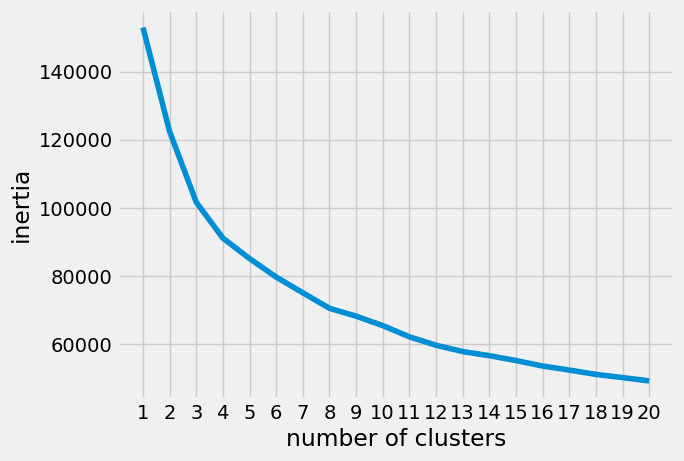

In [60]:
plt.style.use("fivethirtyeight")
plt.plot(range(1,21),cluster_errors)
plt.xticks(range(1,21))
plt.xlabel('number of clusters')
plt.ylabel('inertia')
plt.show()

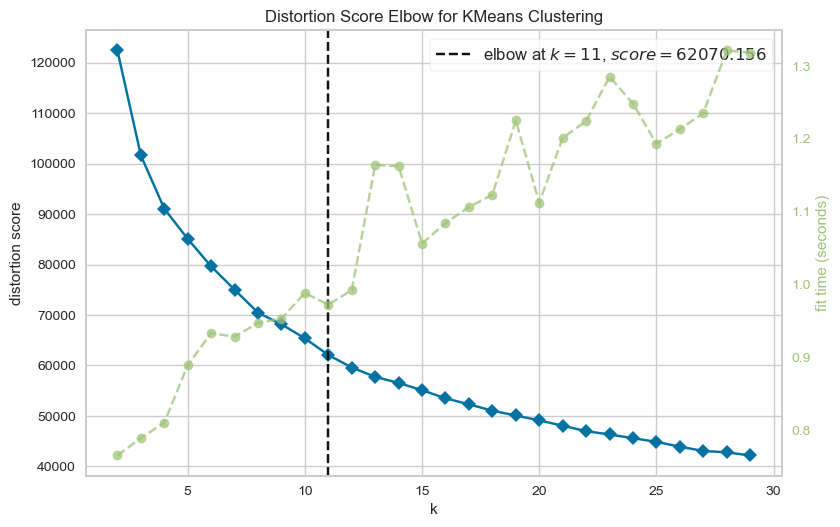

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [61]:
from yellowbrick.cluster import KElbowVisualizer
model = KMeans(n_clusters=k, **kmeans_set)
# k is range of number of clusters.
visualizer = KElbowVisualizer(model, k=(2,30), timings= True)
visualizer.fit(scaled_features)        # Fit data to visualizer
visualizer.show()        # Finalize and render figure

In [62]:
# Now we are going to implement Elbow method to final optimal number of clusters
k1=KneeLocator(range(1,21),cluster_errors , curve='convex', direction= 'decreasing')
k1.elbow

5

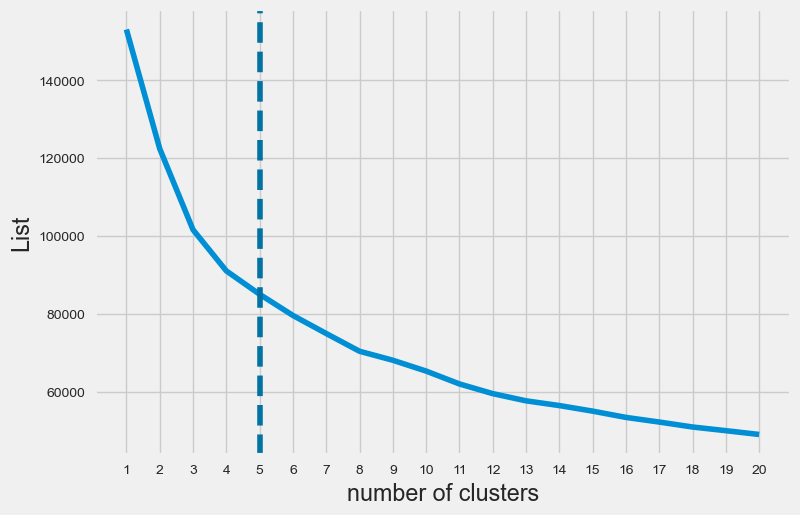

In [63]:
plt.style.use("fivethirtyeight")
plt.plot(range(1,21),cluster_errors)
plt.xticks(range(1,21))
plt.xlabel('number of clusters')
plt.ylabel('List')
plt.axvline(x=k1.elbow, color='b', label= 'axvline-full height', ls= '--')
plt.show()

## 2.2 Silhouette Coefficient Method:
 Average silhouette approach measures the quality of a clustering. That is, it determines how well each object lies within its cluster. A high average silhouette width indicates a good clustering. The optimal number of clusters k is the one that maximize the average silhouette over a range of possible values for k.
 
 The silhouette score falls within the range [-1, 1].

 The silhouette score of 1 means that the clusters are very dense and nicely separated. The score of 0 means that clusters are overlapping. The score of less than 0 means that data belonging to clusters may be wrong/incorrect.

- elbow method: k=5 , k=10 
- silhouette coefficiennt: k=3

In [64]:
#let's try silhouette_score for k=5,10,3

# Instantiate the KMeans for 5 clusters
km = KMeans(n_clusters=5, random_state=42)
# Fit the KMeans model
km.fit_predict(scaled_features)
# Calculate Silhoutte Score
score = silhouette_score(scaled_features, km.labels_, metric='euclidean')
# Print the score
print('Silhouetter Average Score: %.3f' % score)

Silhouetter Average Score: 0.182


In [65]:

# Instantiate the KMeans for 10 clusters
km = KMeans(n_clusters=10, random_state=42)
# Fit the KMeans model
km.fit_predict(scaled_features)
# Calculate Silhoutte Score
score = silhouette_score(scaled_features, km.labels_, metric='euclidean')
# Print the score
print('Silhouetter Average Score: %.3f' % score)

Silhouetter Average Score: 0.201


In [66]:

# Instantiate the KMeans for 3 clusters
km = KMeans(n_clusters=3, random_state=42)
# Fit the KMeans model
km.fit_predict(scaled_features)
# Calculate Silhoutte Score
score = silhouette_score(scaled_features, km.labels_, metric='euclidean')
# Print the score
print('Silhouetter Average Score: %.3f' % score)

Silhouetter Average Score: 0.244


In [67]:
# Instantiate the KMeans for 2 clusters
km = KMeans(n_clusters=2, random_state=42)
# Fit the KMeans model
km.fit_predict(scaled_features)
# Calculate Silhoutte Score
score = silhouette_score(scaled_features, km.labels_, metric='euclidean')
# Print the score
print('Silhouetter Average Score: %.3f' % score)

Silhouetter Average Score: 0.207


#### the best silhouette_score k=3

In [68]:
silhouette_coefficients =[]
for k in range(2,21):#1 is the worse
    kmeans=KMeans(n_clusters=k, **kmeans_set)
    kmeans.fit(scaled_features)
    score= silhouette_score(scaled_features, kmeans.labels_)
    silhouette_coefficients.append(score)

In [69]:
silhouette_coefficients

[0.2066039743569849,
 0.24359369060589742,
 0.18824367090222374,
 0.18195663678649823,
 0.19108742874546056,
 0.19627870407453518,
 0.20550067306492553,
 0.20566252926988948,
 0.2022037274963148,
 0.20515997627148094,
 0.2006452088530021,
 0.19900574524497583,
 0.19691732608439416,
 0.16080710062082554,
 0.17386190400586027,
 0.17021939140288175,
 0.18171018117600163,
 0.18471643413840014,
 0.18247910023628883]

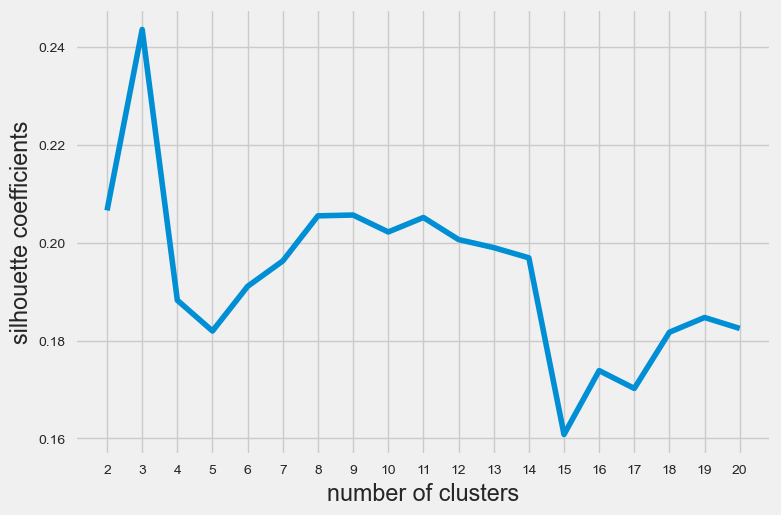

In [70]:
plt.style.use("fivethirtyeight")
plt.plot(range(2,21),silhouette_coefficients)
plt.xticks(range(2,21))
plt.xlabel('number of clusters')
plt.ylabel('silhouette coefficients')
plt.show()

In [71]:
def evaluate_metrics(df1, min_clust=2, max_clust=10, rand_state=42):
    inertias = []
    silhouette = []
    ch_score = []
    db_score = []
    for n_clust in range(min_clust, max_clust):
        kmeans = KMeans(n_clusters=n_clust, random_state=rand_state)
        y_label = kmeans.fit_predict(scaled_features)
        inertias.append(kmeans.inertia_)
        silhouette.append(silhouette_score(scaled_features, y_label))
        ch_score.append(calinski_harabasz_score(scaled_features, y_label))
        db_score.append(davies_bouldin_score(scaled_features, y_label))        

    fig, ax = plt.subplots(2, 2, figsize=(15, 10))
    ax[0][0].plot(range(min_clust, max_clust), inertias, '-x', linewidth=2)
    ax[0][0].set_xlabel('No. of clusters')
    ax[0][0].set_ylabel('Inertia')
    
    ax[0][1].plot(range(min_clust, max_clust), silhouette, '-x', linewidth=2)
    ax[0][1].set_xlabel('No. of clusters')
    ax[0][1].set_ylabel('Silhouette Score')
    
    ax[1][0].plot(range(min_clust, max_clust), ch_score, '-x', linewidth=2)
    ax[1][0].set_xlabel('No. of clusters')
    ax[1][0].set_ylabel('Calinski Harabasz Score')
    
    ax[1][1].plot(range(min_clust, max_clust), db_score, '-x', linewidth=2)
    ax[1][1].set_xlabel('No. of clusters')
    ax[1][1].set_ylabel('Davies Bouldin Score')
    fig.suptitle('Metrics to evaluate the number of clusters')
    plt.show()

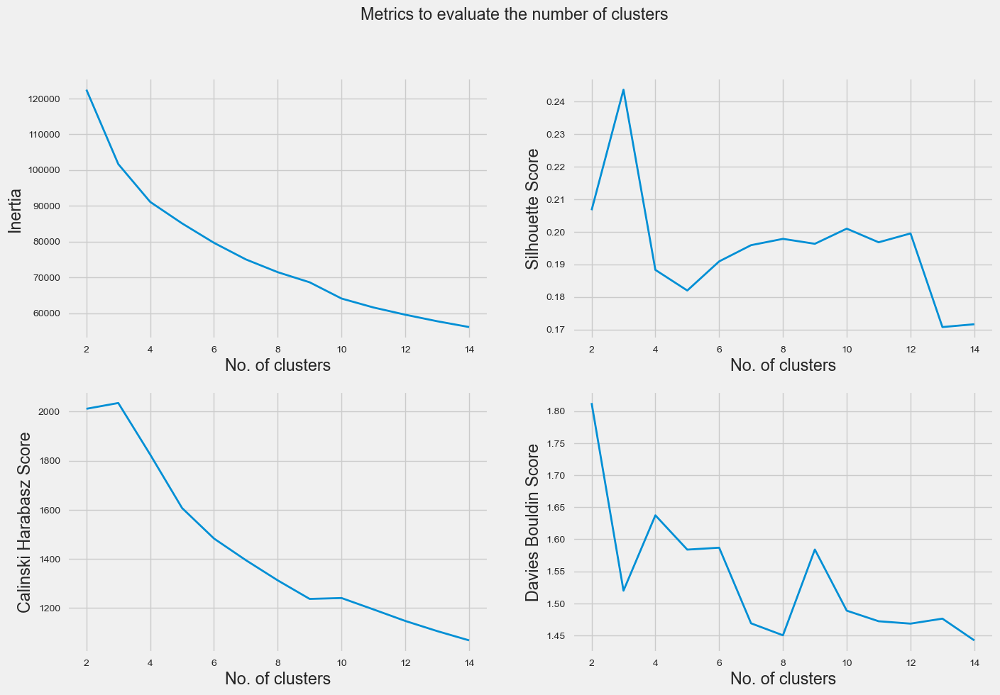

In [72]:
evaluate_metrics(scaled_features, min_clust=2, max_clust=15, rand_state=42)

So based on the plots above we conclude that 3 clusters are the best for k-mean modeling

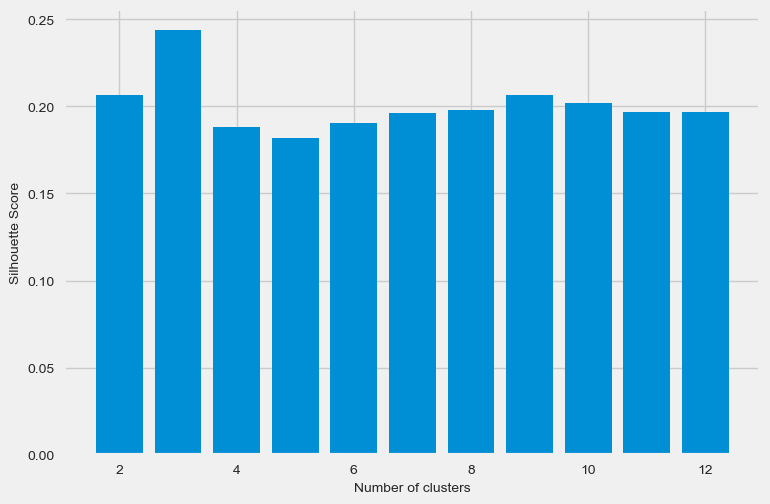

In [73]:
silhouette_scores = []

for n_cluster in range(2, 13):
    silhouette_scores.append( 
        silhouette_score(scaled_features, KMeans(n_clusters = n_cluster).fit_predict(scaled_features))) 
    
# Plotting a bar graph to compare the results 
k = [2, 3, 4, 5, 6,7,8,9,10,11,12] 

plt.bar(k, silhouette_scores) 
plt.xlabel('Number of clusters', fontsize = 10) 
plt.ylabel('Silhouette Score', fontsize = 10) 
plt.show()
#confirming number of clusters

Note : Highest silhouette score is k = 3.

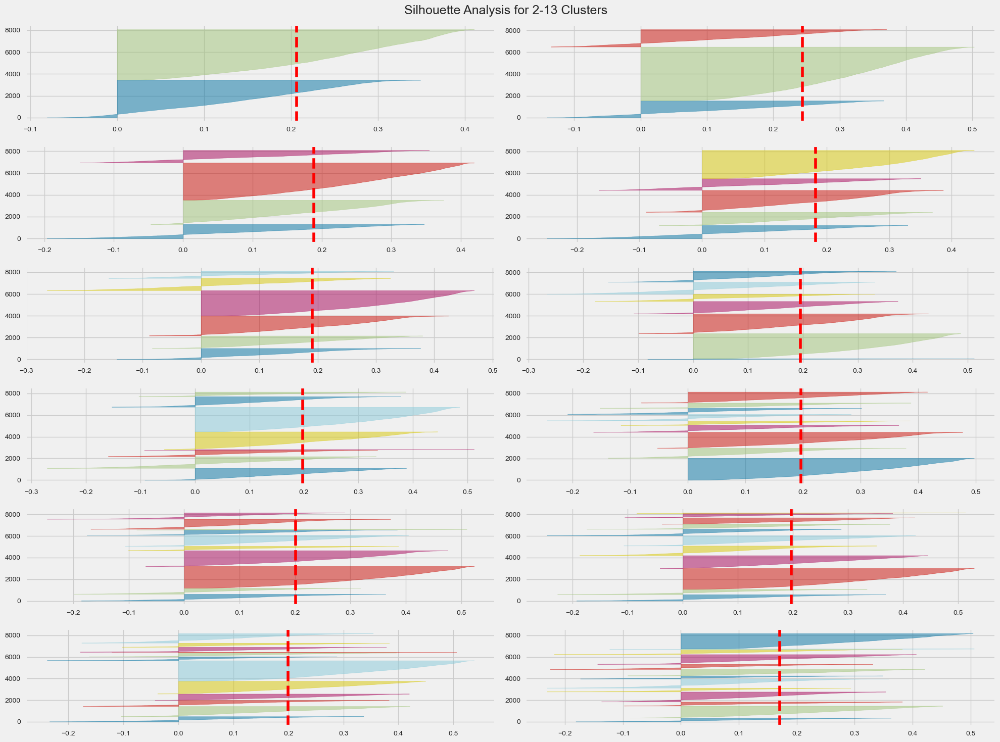

In [74]:
from yellowbrick.cluster import SilhouetteVisualizer
# Yellowbrick extends the Scikit-Learn API to make model selection and hyperparameter tuning easier.
# You can find the code to simply create Silhouette visualisation for K-Means clusters with n_cluster as 2, 3, 4, 5, 6, 7,8,9,10,11,12,13 below.

fig, ax = plt.subplots(6, 2, figsize=(20,15))
fig.suptitle('Silhouette Analysis for 2-13 Clusters', size = 18)
plt.tight_layout()

for i in [2, 3, 4, 5, 6, 7,8,9,10,11,12,13]:
    '''
    Create KMeans instance for different number of clusters
    '''
    km = KMeans(n_clusters=i, init='k-means++', n_init=10, max_iter=100, random_state=42)
    q, mod = divmod(i, 2)
    '''
    Create SilhouetteVisualizer instance with KMeans instance
    Fit the visualizer
    '''
    visualizer = SilhouetteVisualizer(km, colors='yellowbrick', ax=ax[q-1][mod])
    visualizer.fit(scaled_features)

- Having clusters with negative silhouette scores for all values of k in the above plots shows that kmeans has not performed well in clustering, but in any case, it seems that k=3 is the best number of clusters

Conclusion:
- 3 Clusters is chosen,because the highest value in Silhouetter Score and calinski_harabasz_score are positioned at 3th cluster. 

### 2.3 Dendograms 
 This technique is specific to the agglomerative hierarchical method of clustering. The method starts by considering each point as a separate cluster and starts joining points to clusters in a hierarchical fashion based on their distances. To get the optimal number of clusters for hierarchical clustering, we make use a dendrogram which is tree-like chart that shows the sequences of merges or splits of clusters.

In [75]:
distance = linkage(scaled_features,'ward')

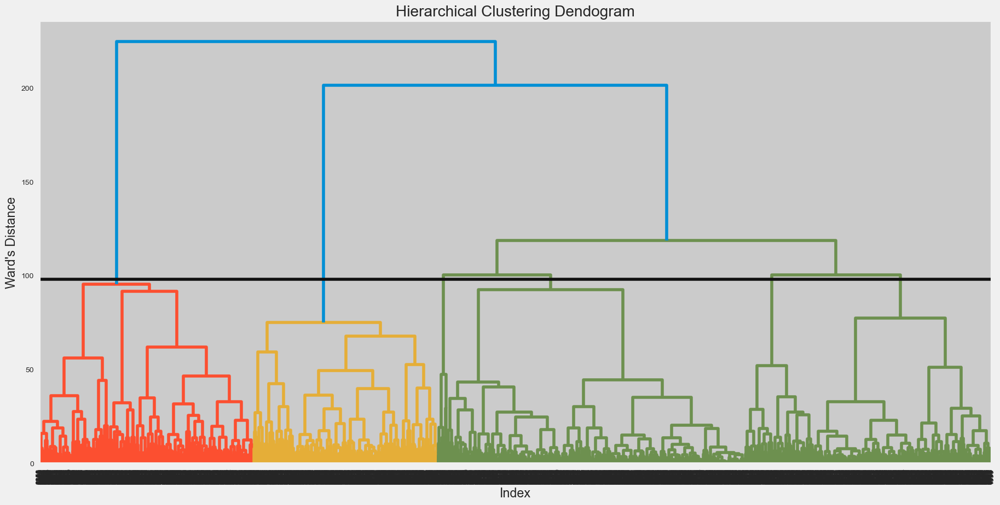

In [76]:
plt.figure(figsize=(20,10))
plt.title("Hierarchical Clustering Dendogram")
plt.xlabel("Index")
plt.ylabel("Ward's Distance")
dendrogram(distance, leaf_rotation=90, leaf_font_size=9);
plt.axhline(98, c='k')

### 2 K-Means Algorithm

In [77]:
# model with 3 clusters
kmeans_3=KMeans(n_clusters=3)
y_kmeans = kmeans_3.fit_predict(scaled_features)
y_kmeans


array([0, 1, 2, ..., 0, 0, 0])

In [78]:
cluster_centers = pd.DataFrame(data = kmeans.cluster_centers_, columns= [df1.columns])
cluster_centers

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,Monthly_avg_purchase,Monthly_cash_advance
0,0.359343,0.453440,2.526117,1.349248,2.746728,-0.372685,1.291285,1.638483,1.524116,-0.435465,-0.386226,3.705904,0.741784,1.114517,0.002335,0.179269,0.337873,2.474390,-0.382517
1,-0.323352,0.383545,0.256630,0.619434,-0.363373,-0.470121,1.095881,2.585781,-0.368881,-0.510040,-0.441539,0.467378,0.416023,-0.107623,-0.193970,0.576604,0.253150,0.245131,-0.469747
2,1.616300,0.247938,-0.582498,-0.398672,-0.517502,3.509595,-0.896099,-0.437213,-0.743169,1.542414,1.589978,-0.603378,1.081973,0.470813,0.331388,-0.453560,-0.083032,-0.593756,3.428810
3,-0.041240,0.379144,1.765285,2.155643,0.305306,-0.460297,0.964395,1.841767,0.445133,-0.499309,-0.448250,1.153903,0.507911,0.554389,-0.140864,0.308607,0.228661,1.762144,-0.461602
4,0.746454,-0.078588,-0.550299,-0.362752,-0.507401,2.730877,-0.889428,-0.460867,-0.728057,0.942428,0.922416,-0.566835,0.774759,4.460699,0.112715,-0.007115,0.283808,-0.562797,2.508154
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15,-0.060027,-0.791932,-0.354973,-0.130660,-0.465008,0.142591,-0.740856,-0.337088,-0.645299,-0.104119,-0.152494,-0.538618,0.708643,2.391391,0.001378,-0.082706,0.265913,-0.364650,0.102289
16,-0.348951,0.343427,-0.154822,-0.414485,0.274323,-0.474065,0.990865,-0.399989,1.209585,-0.514105,-0.440489,0.295520,-0.453980,-0.362608,-0.072908,-0.278151,0.289641,-0.170465,-0.475163
17,0.211042,0.355078,-0.646347,-0.440297,-0.576930,0.603731,-0.989337,-0.472852,-0.813232,1.150238,0.895631,-0.628821,-0.309316,-0.123827,-0.045908,-0.421756,0.245229,-0.658473,0.532821
18,-0.106282,0.426395,-0.631328,-0.440279,-0.549836,-0.347549,-0.892316,-0.439445,-0.741751,-0.193293,-0.274637,-0.605315,-0.468240,-0.454479,-0.070452,-0.454768,0.254397,-0.643240,-0.356414


In [79]:
kmeans_3.labels_


array([0, 1, 2, ..., 0, 0, 0])

In [80]:
pd.Series(kmeans_3.labels_).value_counts()

0    4920
1    1587
2    1547
dtype: int64

In [81]:
df1['kmeans_3.labels_']=kmeans_3.labels_

In [82]:
# Create a list of all the features
features = ['BALANCE', 'BALANCE_FREQUENCY', 'PURCHASES',
       'ONEOFF_PURCHASES', 'INSTALLMENTS_PURCHASES', 'CASH_ADVANCE',
       'PURCHASES_FREQUENCY', 'ONEOFF_PURCHASES_FREQUENCY',
       'PURCHASES_INSTALLMENTS_FREQUENCY', 'CASH_ADVANCE_FREQUENCY',
       'CASH_ADVANCE_TRX', 'PURCHASES_TRX', 'CREDIT_LIMIT', 'PAYMENTS',
       'MINIMUM_PAYMENTS', 'PRC_FULL_PAYMENT', 'TENURE']

In [83]:
# Plot the average feature value for each cluster
describe_clusters = scaled_df.groupby(df1['kmeans_3.labels_']).mean()
describe_clusters


,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,Monthly_avg_purchase,Monthly_cash_advance
kmeans_3.labels_,,,,,,,,,,,,,,,,,,,
0,-0.345426,-0.218689,-0.345597,-0.286737,-0.239659,-0.383209,-0.095195,-0.250007,-0.063111,-0.338763,-0.336097,-0.268728,-0.292907,-0.351983,-0.104567,0.027457,-0.041030,-0.338549,-0.378181
1,1.056999,0.284732,-0.524003,-0.353418,-0.472402,1.563273,-0.752539,-0.375063,-0.628272,1.454626,1.402183,-0.509266,0.433292,0.529020,0.349078,-0.405097,-0.127979,-0.528118,1.554609
2,0.014246,0.403413,1.636672,1.274480,1.246817,-0.384954,1.074750,1.179870,0.845232,-0.414852,-0.369532,1.377082,0.487052,0.576731,-0.025546,0.328248,0.261777,1.618477,-0.392058


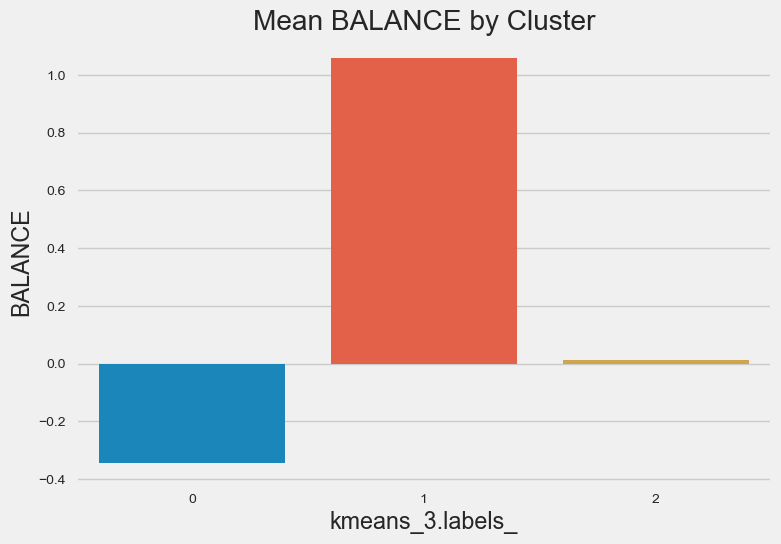

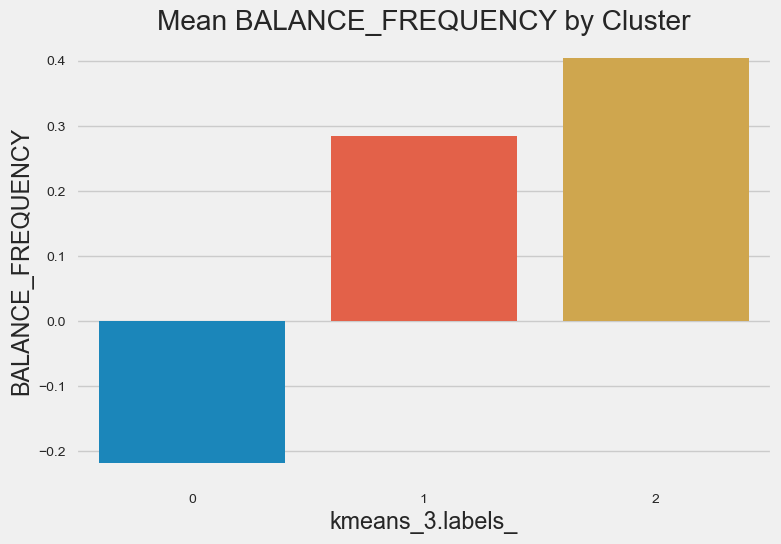

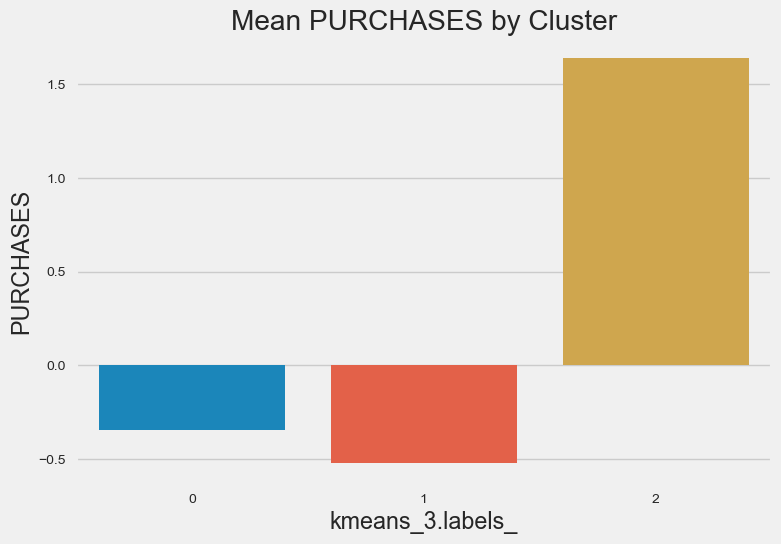

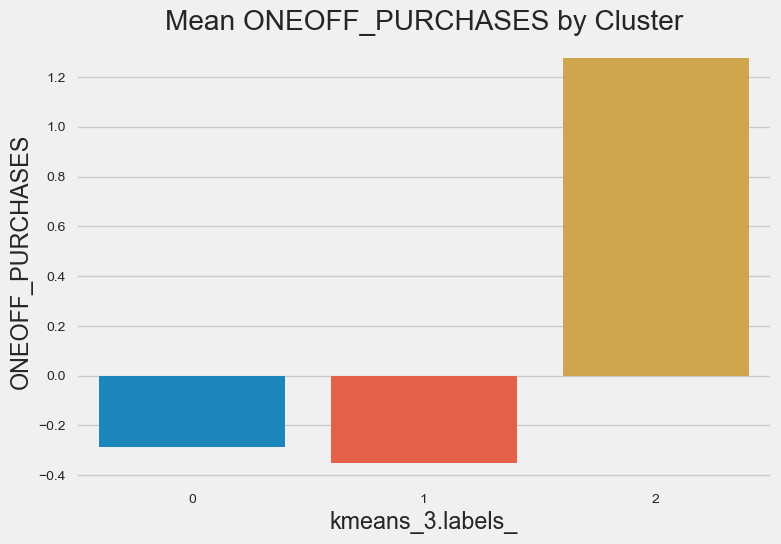

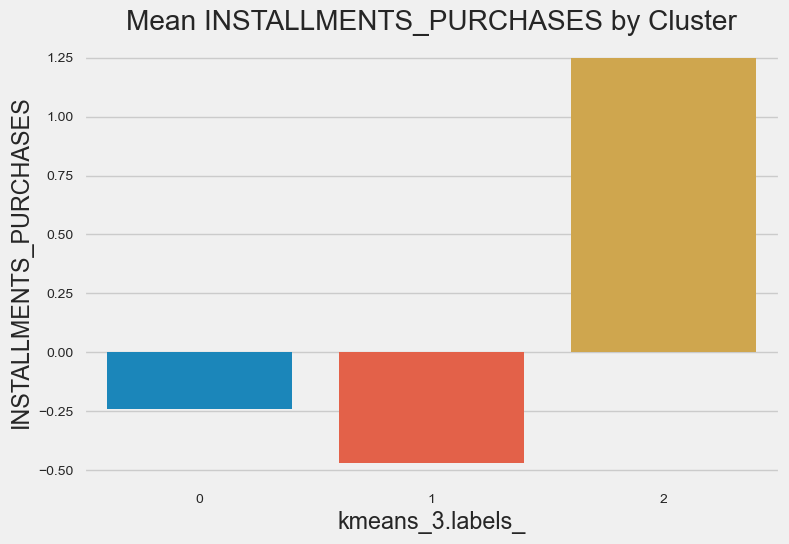

...

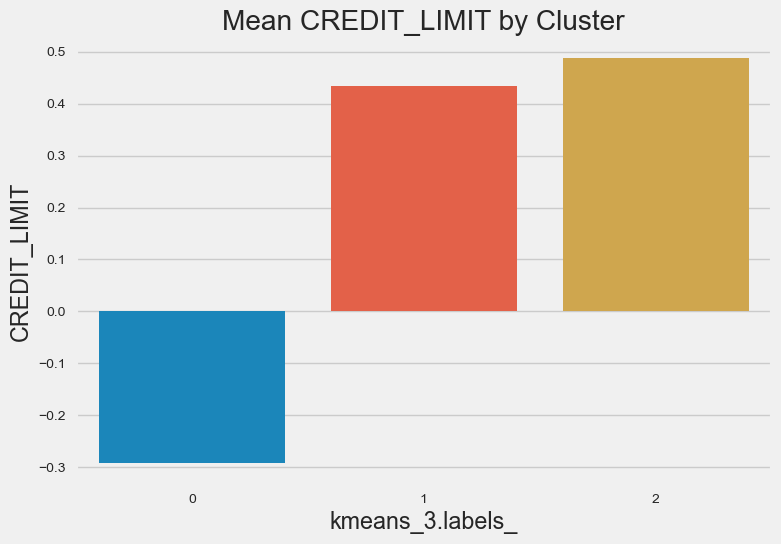

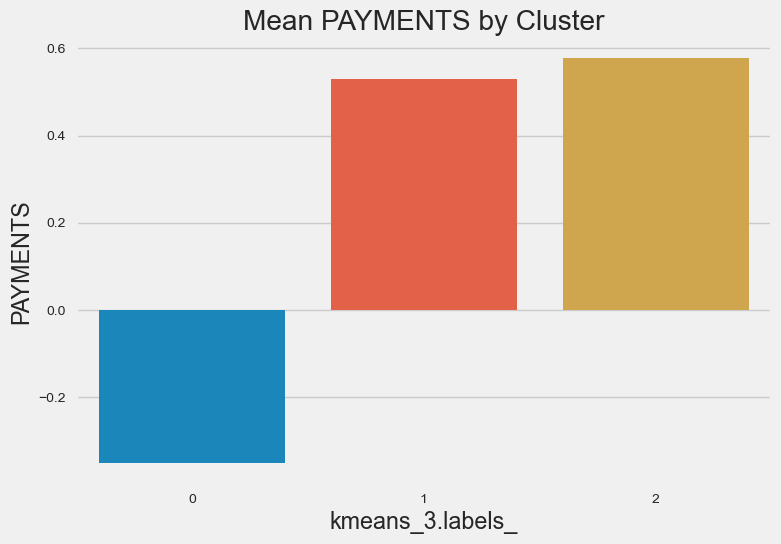

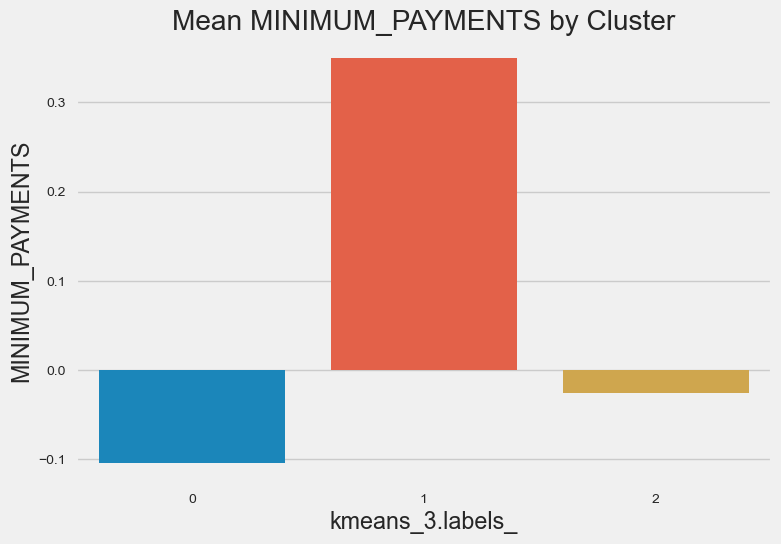

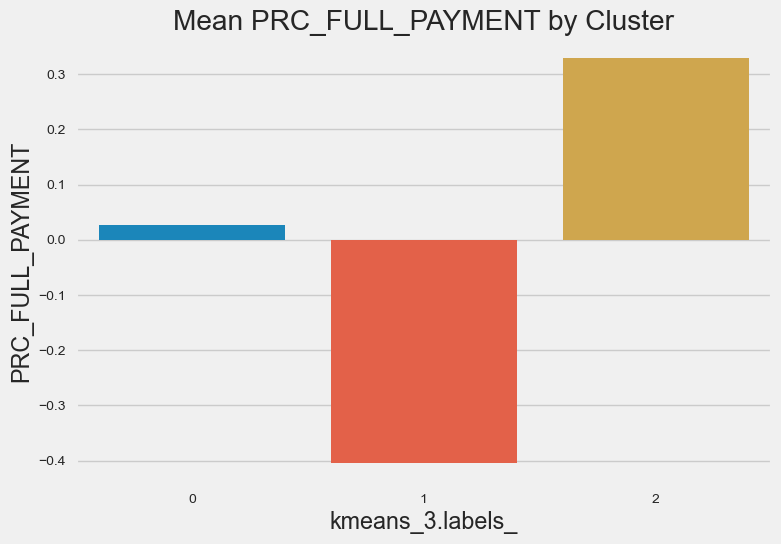

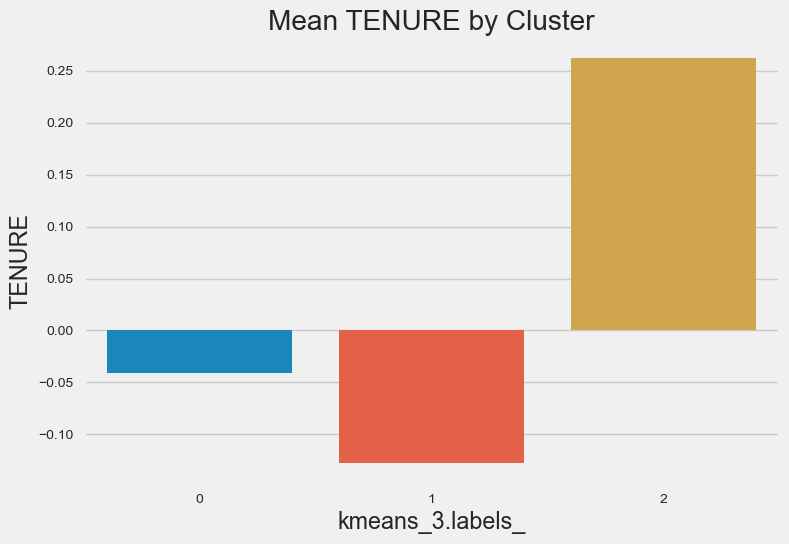

In [84]:
for i in features:
    
    sns.barplot(x = describe_clusters.index
               , y = i
               , data = describe_clusters)
    plt.title('Mean ' + str(i) + ' by Cluster')
    plt.show()

In [85]:
df1.head(10)

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,Monthly_avg_purchase,Monthly_cash_advance,kmeans_3.labels_
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12,7.950000,0.000000,0
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12,0.000000,536.912124,1
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12,64.430833,0.000000,2
3,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,0.000000,0.000000,12,124.916667,17.149001,0
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12,1.333333,0.000000,0
5,1809.828751,1.000000,1333.28,0.00,1333.28,0.000000,0.666667,0.000000,0.583333,0.000000,0,8,1800.0,1400.057770,2407.246035,0.000000,12,111.106667,0.000000,0
6,1823.652743,1.000000,436.20,0.00,436.20,0.000000,1.000000,0.000000,1.000000,0.000000,0,12,2300.0,679.065082,532.033990,0.000000,12,36.350000,0.000000,0
7,1014.926473,1.000000,861.49,661.49,200.00,0.000000,0.333333,0.083333,0.250000,0.000000,0,5,7000.0,688.278568,311.963409,0.000000,12,71.790833,0.000000,0
8,152.225975,0.545455,1281.60,1281.60,0.00,0.000000,0.166667,0.166667,0.000000,0.000000,0,3,11000.0,1164.770591,100.302262,0.000000,12,106.800000,0.000000,0
9,1293.124939,1.000000,920.12,0.00,920.12,0.000000,1.000000,0.000000,1.000000,0.000000,0,12,1200.0,1083.301007,2172.697765,0.000000,12,76.676667,0.000000,0


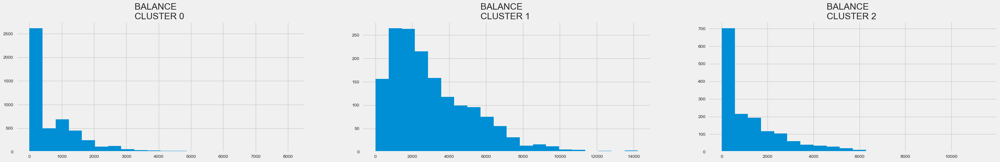

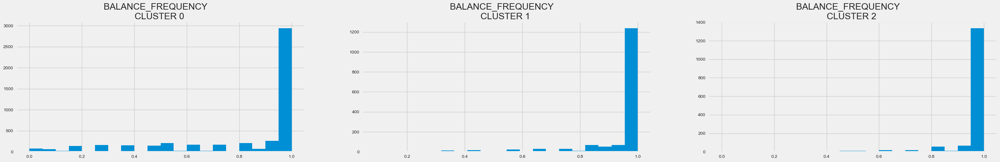

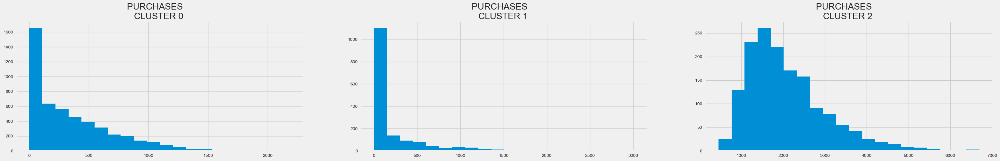

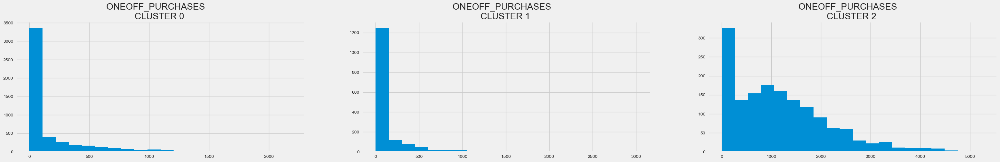

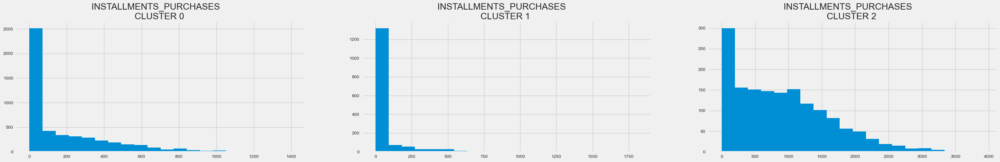

...

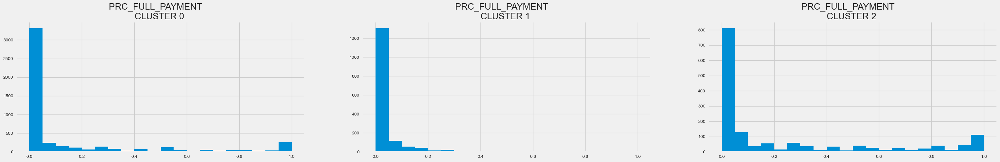

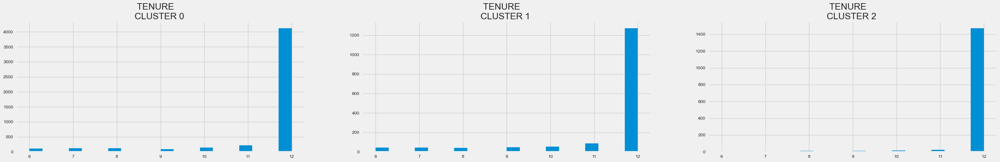

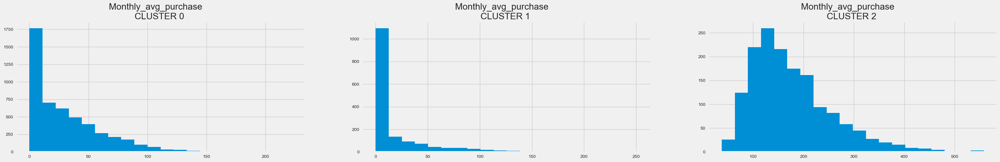

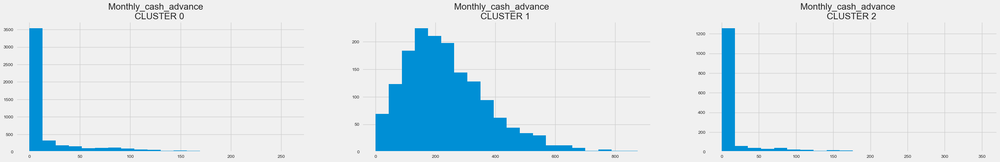

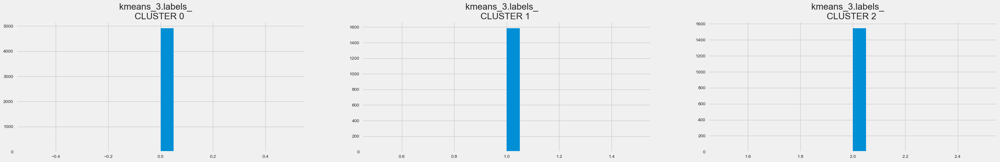

In [86]:
# Plot the histogram of various clusters
for i in df1.columns:
    plt.figure(figsize = (35, 5))
    for j in range(3):
        plt.subplot(1,3,j+1)
        ax = df1[df1['kmeans_3.labels_'] == j]
        ax[i].hist(bins=20)
        plt.title('{}    \nCLUSTER {} '.format(i,j))
         
plt.show()

### 2.1 Principal componenet Analysis (PCA)

In [87]:
#Lets convert our data to only 2D using PCA
pca = PCA(n_components=2)
pca_components = pca.fit_transform(scaled_features)
pca_components

array([[-0.98056653, -2.14722295],
       [-4.07507362,  4.02215975],
       [ 1.48801957,  0.55408154],
       ...,
       [ 0.4790546 , -1.96727106],
       [ 0.0124049 , -2.43662656],
       [-1.87042278, -2.26444492]])

In [88]:
# create a dataframe of these two componenets
pca_df = pd.DataFrame(data = pca_components, columns = ['pca1', 'pca2'])
pca_df.head()

,pca1,pca2
0,-0.980567,-2.147223
1,-4.075074,4.022160
2,1.488020,0.554082
3,0.292967,0.040387
4,-1.165750,-1.697506


In [89]:
# Concatenate the clusters labels to the dataframe
pca_df = pd.concat([pca_df,pd.DataFrame({'cluster':kmeans_3.labels_})], axis = 1)
pca_df.head()

,pca1,pca2,cluster
0,-0.980567,-2.147223,0
1,-4.075074,4.022160,1
2,1.488020,0.554082,2
3,0.292967,0.040387,0
4,-1.165750,-1.697506,0


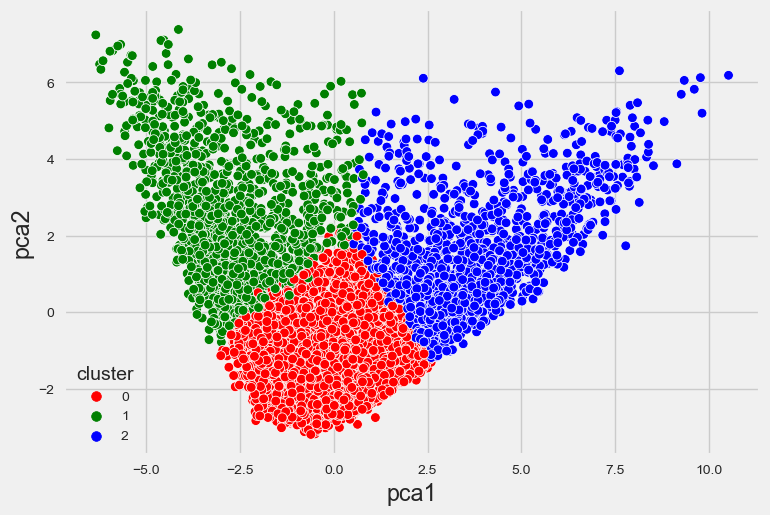

In [90]:
# Visualize the clusters in 2-axes plane
ax = sns.scatterplot(x="pca1", y="pca2", hue = "cluster", data = pca_df, palette =['red','green','blue'])
plt.show()

Text(65.51873285322358, 0.5, 'PURCHASES')

<Figure size 1000x600 with 0 Axes>

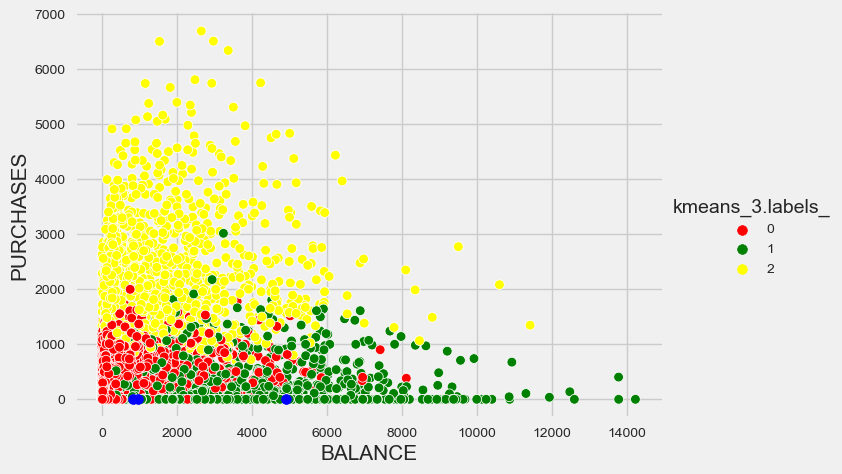

In [91]:
kmeans = KMeans(n_clusters=3,init= "random", random_state = 42).fit(df1)
centroids = kmeans.cluster_centers_
plt.figure(figsize=(10,6))

df_kmean = df1.copy()
df_kmean['cluster'] = kmeans.labels_
sns.relplot(data = df_kmean ,x='BALANCE', y='PURCHASES', hue="kmeans_3.labels_", palette=['red','green','yellow'] ,kind='scatter', aspect = 11.7/8.27)
plt.scatter(centroids[:, 0], centroids[:,1], c='blue', s=50)
plt.xlabel("BALANCE",fontsize=15)
plt.ylabel("PURCHASES",fontsize=15)

Text(67.36603330431569, 0.5, 'CASH_ADVANCE')

<Figure size 1000x600 with 0 Axes>

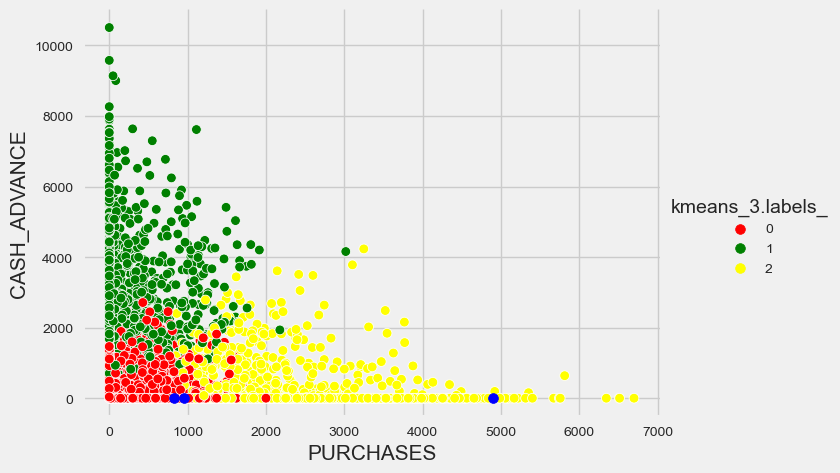

In [92]:
kmeans = KMeans(n_clusters=3,init= "random", random_state = 42).fit(df1)
centroids = kmeans.cluster_centers_
plt.figure(figsize=(10,6))

df_kmean = df1.copy()
df_kmean['cluster'] = kmeans.labels_
sns.relplot(data = df_kmean ,x='PURCHASES', y='CASH_ADVANCE', hue="kmeans_3.labels_", palette=['red','green','yellow'] ,kind='scatter', aspect = 11.7/8.27)
plt.scatter(centroids[:, 0], centroids[:,1], c='blue', s=50)
plt.xlabel("PURCHASES",fontsize=15)
plt.ylabel("CASH_ADVANCE",fontsize=15)

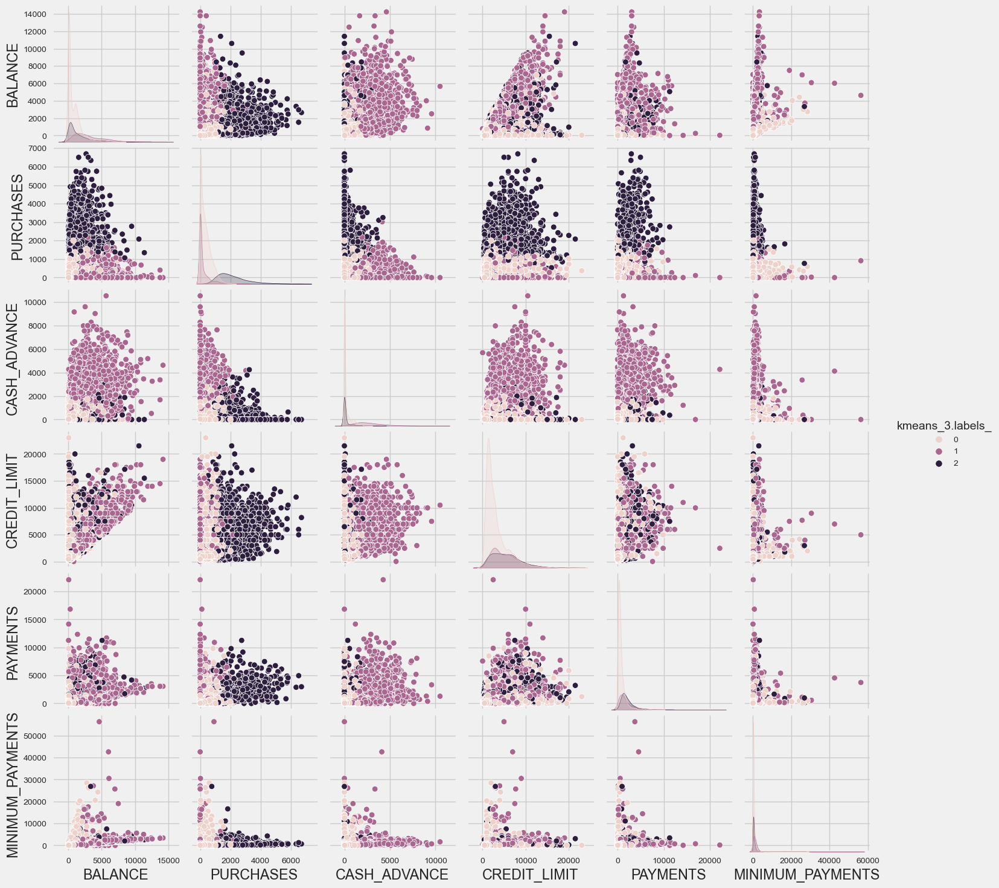

In [93]:
best_cols = ["BALANCE", "PURCHASES", "CASH_ADVANCE","CREDIT_LIMIT", "PAYMENTS", "MINIMUM_PAYMENTS","kmeans_3.labels_"]
sns.pairplot(df1[ best_cols ], hue="kmeans_3.labels_")

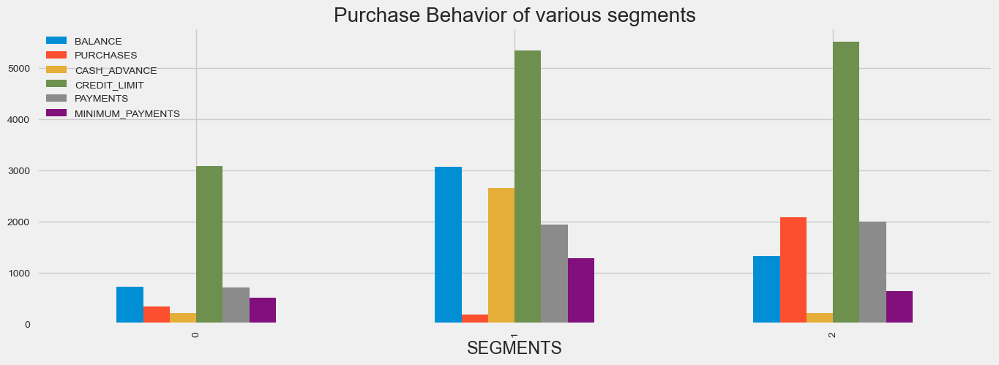

In [94]:
(df1[["BALANCE", "PURCHASES", "CASH_ADVANCE","CREDIT_LIMIT", "PAYMENTS", "MINIMUM_PAYMENTS","kmeans_3.labels_"]]
 .groupby("kmeans_3.labels_").mean().plot.bar(figsize=(15, 5)))
plt.title('Purchase Behavior of various segments')
plt.xlabel('SEGMENTS');

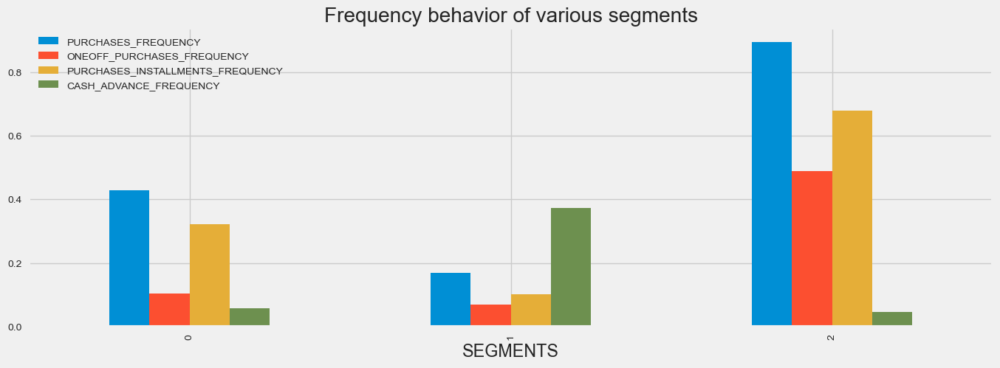

In [95]:
(df1[['PURCHASES_FREQUENCY', 'ONEOFF_PURCHASES_FREQUENCY', 'PURCHASES_INSTALLMENTS_FREQUENCY', 'CASH_ADVANCE_FREQUENCY',"kmeans_3.labels_"]]
 .groupby("kmeans_3.labels_").mean().plot.bar(figsize=(15, 5)))
plt.title('Frequency behavior of various segments')
plt.xlabel('SEGMENTS');

### 3. Hierarchical clustering
 Hierarchical clustering (also called hierarchical cluster analysis or HCA) is a method of cluster analysis that seeks to build a hierarchy of clusters. It's used to group objects in clusters based on how similar they are to each other. In general, the merges and splits are determined in a greedy manner. The results of hierarchical clustering are usually presented in a dendrogram.

In [187]:
# Training model
df_AgglomerativeC = scaled_df.copy()
AgglomerativeC = AgglomerativeClustering(n_clusters=2, affinity = 'euclidean', linkage = 'ward')
y_AgglomerativeC = AgglomerativeC.fit_predict(df_AgglomerativeC)


In [119]:
# We called the df, that's why we need to refer to previous df to add cluster numbers

# Checking number of items in clusters and creating 'Cluster' column
df_AgglomerativeC['Cluster'] = y_AgglomerativeC
df_AgglomerativeC['Cluster'].value_counts()

0    6236
1    1818
Name: Cluster, dtype: int64

In [98]:
def evaluate_metrics(df1, min_clust=2, max_clust=10, rand_state=42):

    silhouette = []
    ch_score = []
    db_score = []
    for n_clust in range(min_clust, max_clust):
        AgglomerativeC = AgglomerativeClustering(n_clusters=n_clust, affinity = 'euclidean', linkage = 'ward')
        y_label = AgglomerativeC.fit_predict(df_AgglomerativeC)
        
        silhouette.append(silhouette_score(scaled_features, y_label))
        ch_score.append(calinski_harabasz_score(scaled_features, y_label))
        db_score.append(davies_bouldin_score(scaled_features, y_label))        

    
    fig, ax = plt.subplots(2, 2, figsize=(15, 10))
    ax[0][0].plot(range(min_clust, max_clust), silhouette, '-x', linewidth=2)
    ax[0][0].set_xlabel('No. of clusters')
    ax[0][0].set_ylabel('Silhouette Score')
    
    ax[0][1].plot(range(min_clust, max_clust), ch_score, '-x', linewidth=2)
    ax[0][1].set_xlabel('No. of clusters')
    ax[0][1].set_ylabel('Calinski Harabasz Score')
    
    ax[1][0].plot(range(min_clust, max_clust), db_score, '-x', linewidth=2)
    ax[1][0].set_xlabel('No. of clusters')
    ax[1][0].set_ylabel('Davies Bouldin Score')
    fig.suptitle('Metrics to evaluate the number of clusters')
    plt.show()

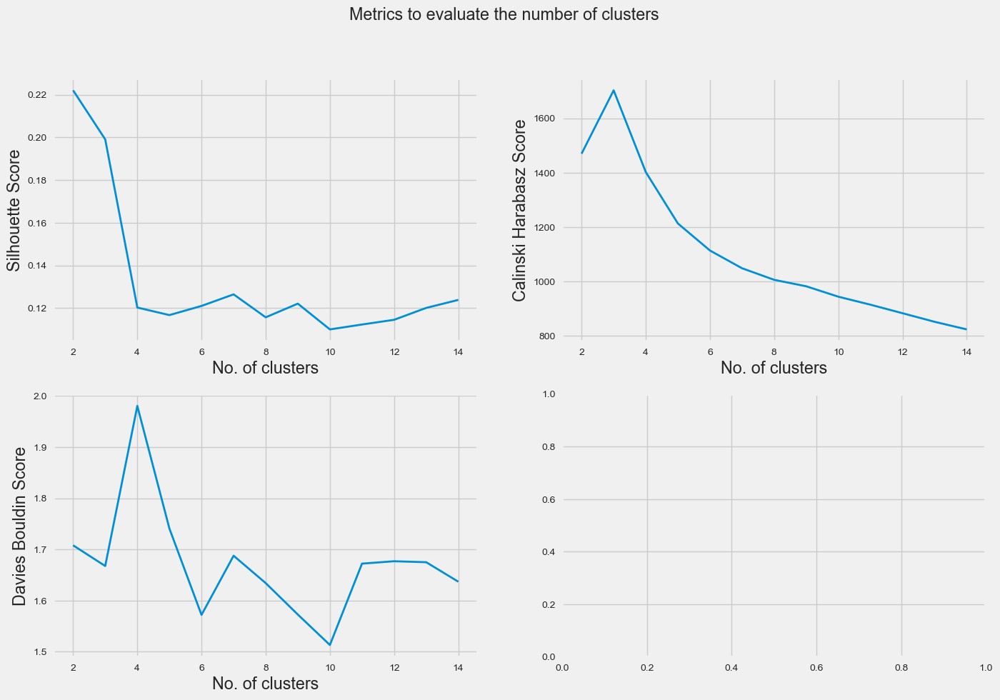

In [99]:
evaluate_metrics(scaled_features, min_clust=2, max_clust=15, rand_state=42)

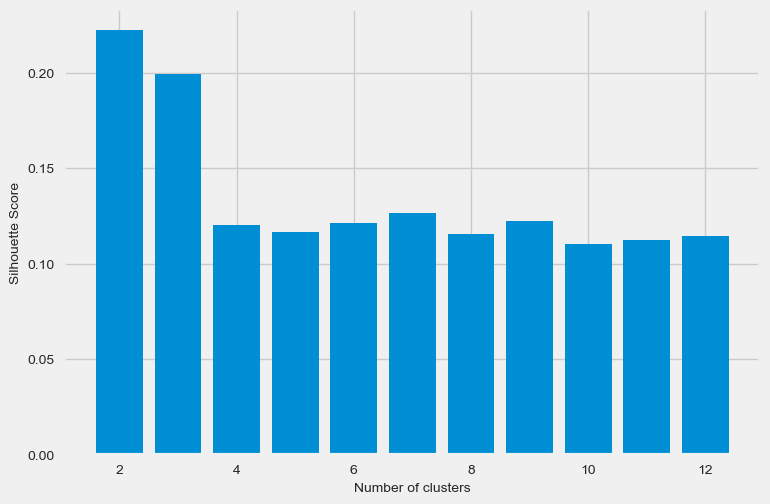

In [100]:
silhouette_scores = []

for n_cluster in range(2, 13):
    silhouette_scores.append( 
        silhouette_score(scaled_features, AgglomerativeClustering(n_clusters = n_cluster).fit_predict(df_AgglomerativeC))) 
    
# Plotting a bar graph to compare the results 
k = [2, 3, 4, 5, 6,7,8,9,10,11,12] 

plt.bar(k, silhouette_scores) 
plt.xlabel('Number of clusters', fontsize = 10) 
plt.ylabel('Silhouette Score', fontsize = 10) 
plt.show()
#confirming number of clusters

Note : Highest silhouette score is k = 2.

In [101]:
# Instantiate the AgglomerativeC for 2 clusters
AgglomerativeC = AgglomerativeClustering(n_clusters=2, affinity = 'euclidean', linkage = 'ward')
# Fit the AgglomerativeC model
AgglomerativeC.fit_predict(df_AgglomerativeC)
# Calculate Silhoutte Score
score = silhouette_score(scaled_features, AgglomerativeC.labels_, metric='euclidean')
# Print the score
print('Silhouetter Average Score: %.3f' % score)

Silhouetter Average Score: 0.222


In [102]:
# Instantiate the AgglomerativeC for 3 clusters
AgglomerativeC = AgglomerativeClustering(n_clusters=3, affinity = 'euclidean', linkage = 'ward')
# Fit the AgglomerativeC model
AgglomerativeC.fit_predict(df_AgglomerativeC)
# Calculate Silhoutte Score
score = silhouette_score(scaled_features, AgglomerativeC.labels_, metric='euclidean')
# Print the score
print('Silhouetter Average Score: %.3f' % score)

Silhouetter Average Score: 0.199


In [120]:
AgglomerativeC = AgglomerativeClustering(n_clusters=2, affinity = 'euclidean', linkage = 'ward')
y_AgglomerativeC = AgglomerativeC.fit_predict(df_AgglomerativeC)

In [121]:
# Checking number of items in clusters and creating 'Cluster' column
df_AgglomerativeC['Cluster'] = y_AgglomerativeC
df_AgglomerativeC['Cluster'].value_counts()

0    6236
1    1818
Name: Cluster, dtype: int64

In [122]:
describe_clusters1 = scaled_df.groupby(df_AgglomerativeC['Cluster']).mean()
describe_clusters1

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,Monthly_avg_purchase,Monthly_cash_advance
Cluster,,,,,,,,,,,,,,,,,,,
0,-0.003243,-0.125980,-0.385035,-0.332323,-0.250076,0.116340,-0.280503,-0.362993,-0.167959,0.121767,0.109755,-0.330128,-0.080154,-0.126749,0.004231,-0.028042,-0.087959,-0.377411,0.118249
1,0.011125,0.432128,1.320724,1.139915,0.857797,-0.399063,0.962166,1.245118,0.576123,-0.417678,-0.376476,1.132386,0.274939,0.434769,-0.014514,0.096188,0.301712,1.294572,-0.405613


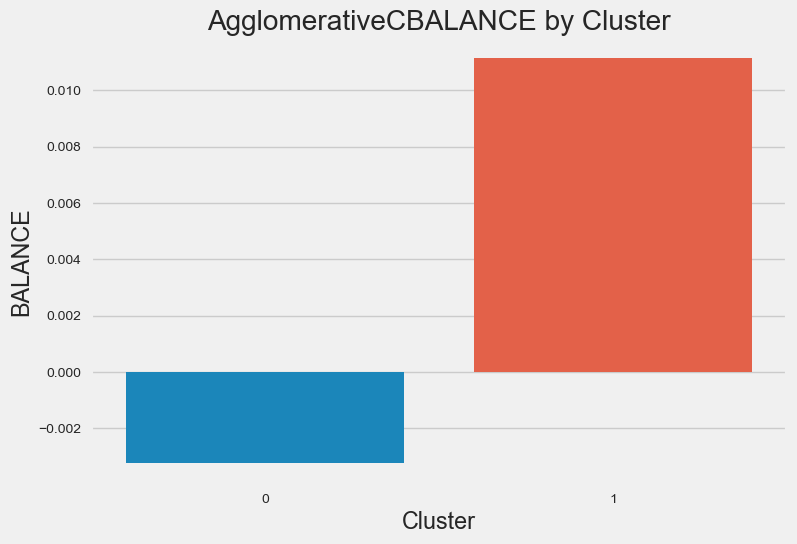

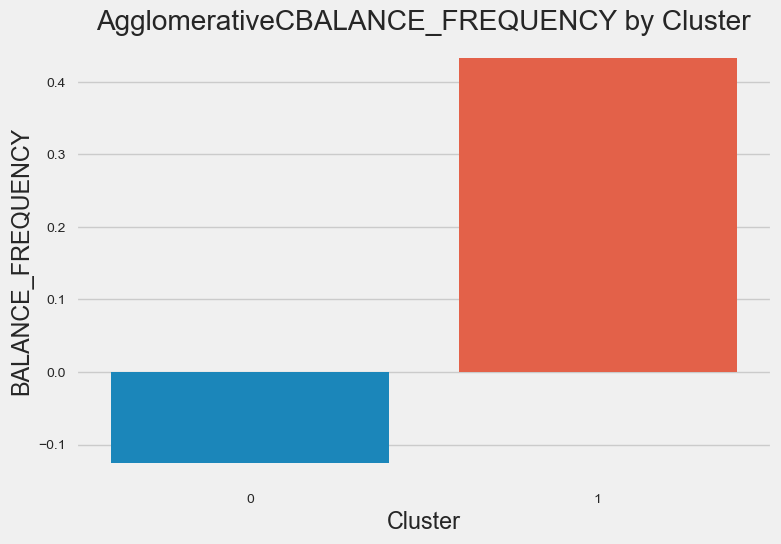

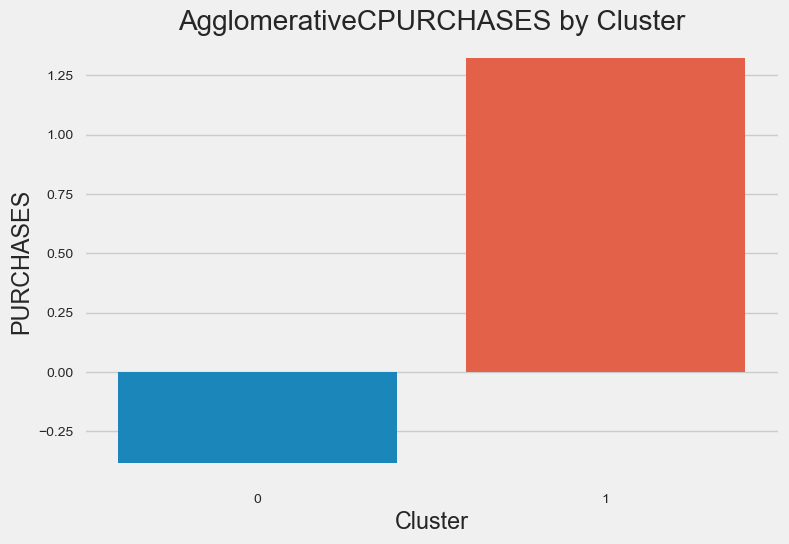

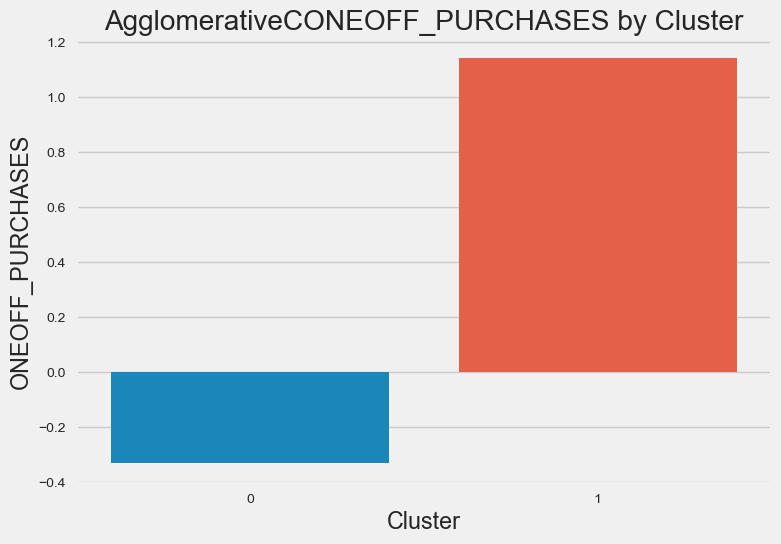

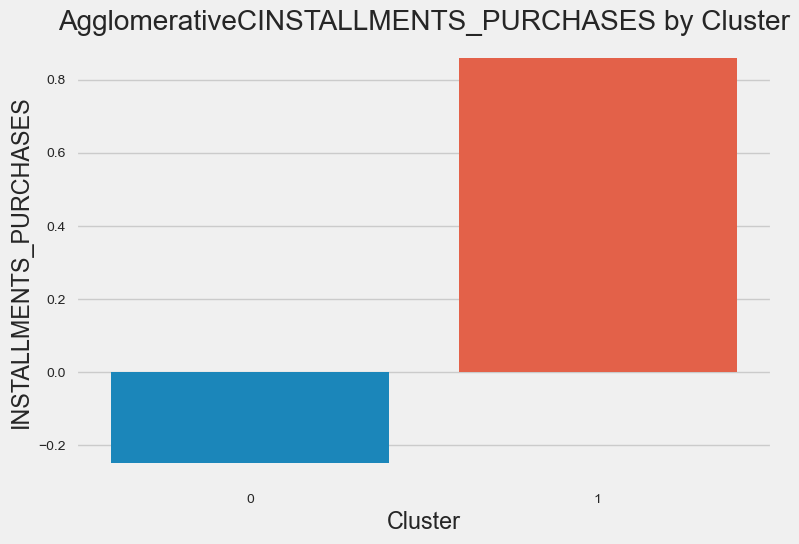

...

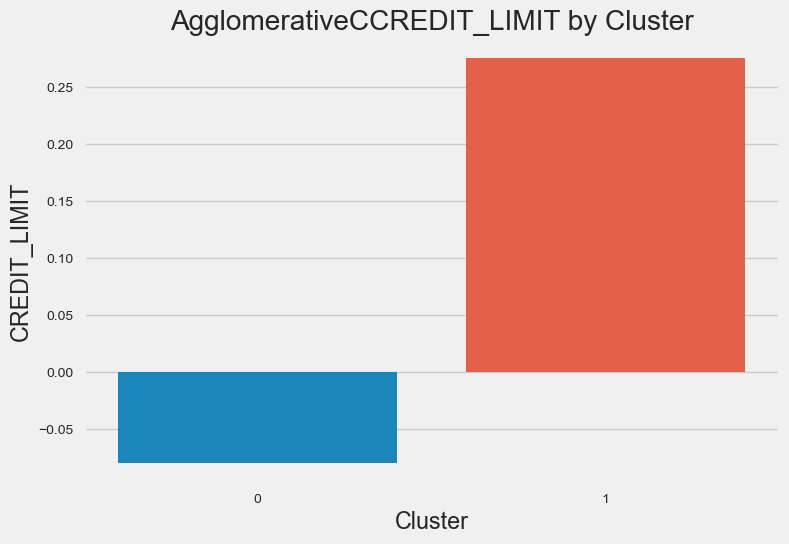

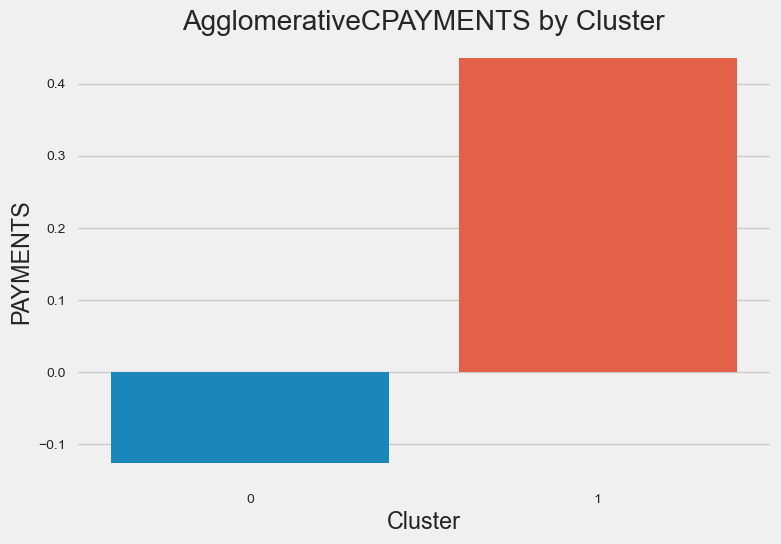

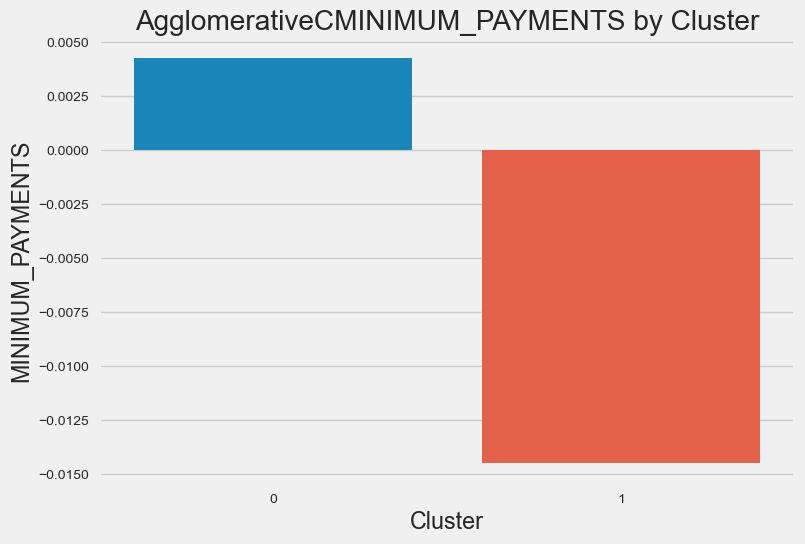

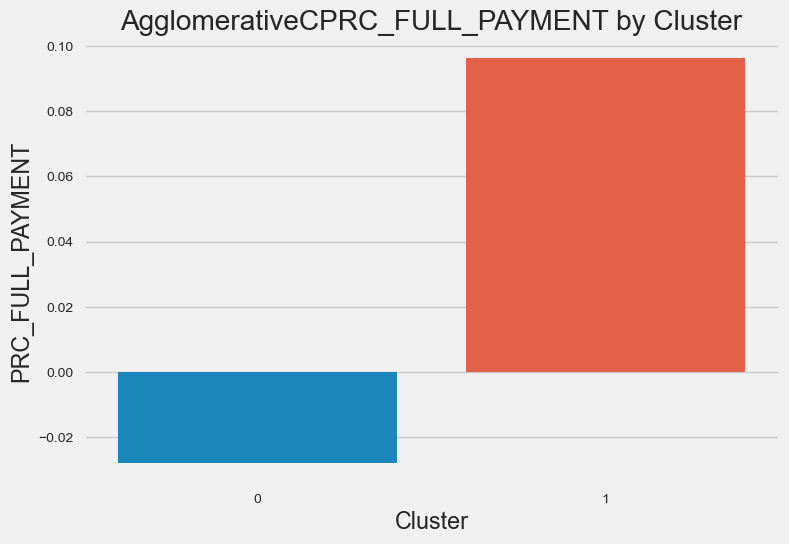

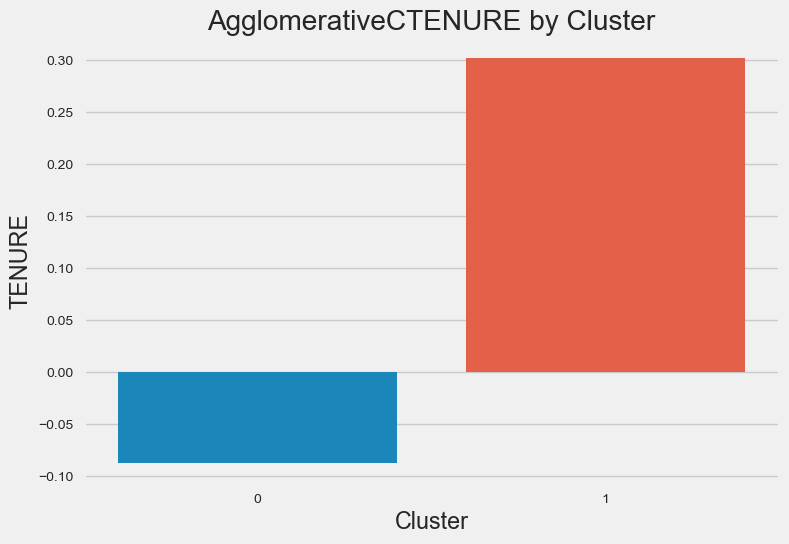

In [123]:
for i in features:
    
    sns.barplot(x = describe_clusters1.index
               , y = i
               , data = describe_clusters1)
    plt.title('AgglomerativeC' + str(i) + ' by Cluster')
    plt.show()

In [124]:
# create a dataframe of these two componenets
pca_df1 = pd.DataFrame(data = pca_components, columns = ['pca1', 'pca2'])
pca_df1.head()

,pca1,pca2
0,-0.980567,-2.147223
1,-4.075074,4.022160
2,1.488020,0.554082
3,0.292967,0.040387
4,-1.165750,-1.697506


In [125]:
# Concatenate the clusters labels to the dataframe
pca_df1 = pd.concat([pca_df1,pd.DataFrame({'cluster1':y_AgglomerativeC})], axis = 1)
pca_df1.head()

,pca1,pca2,cluster1
0,-0.980567,-2.147223,0
1,-4.075074,4.022160,0
2,1.488020,0.554082,1
3,0.292967,0.040387,0
4,-1.165750,-1.697506,0


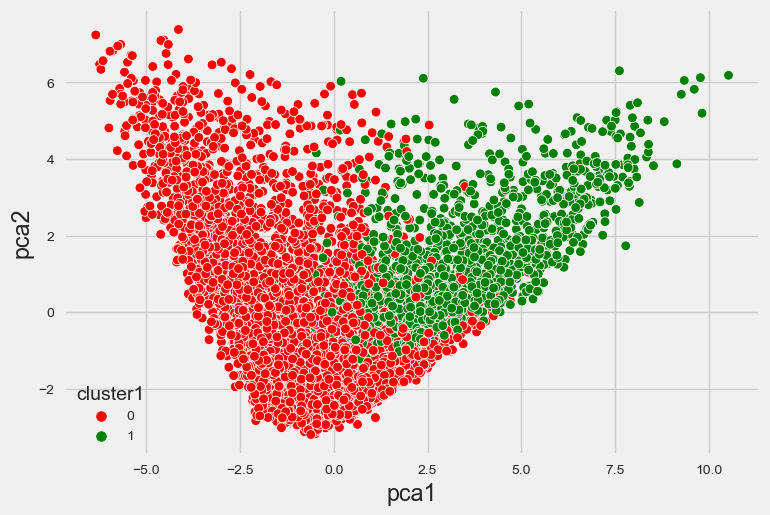

In [126]:
# Visualize the clusters in 2-axes plane
ax = sns.scatterplot(x="pca1", y="pca2", hue = "cluster1", data = pca_df1, palette =['red','green'])
plt.show()

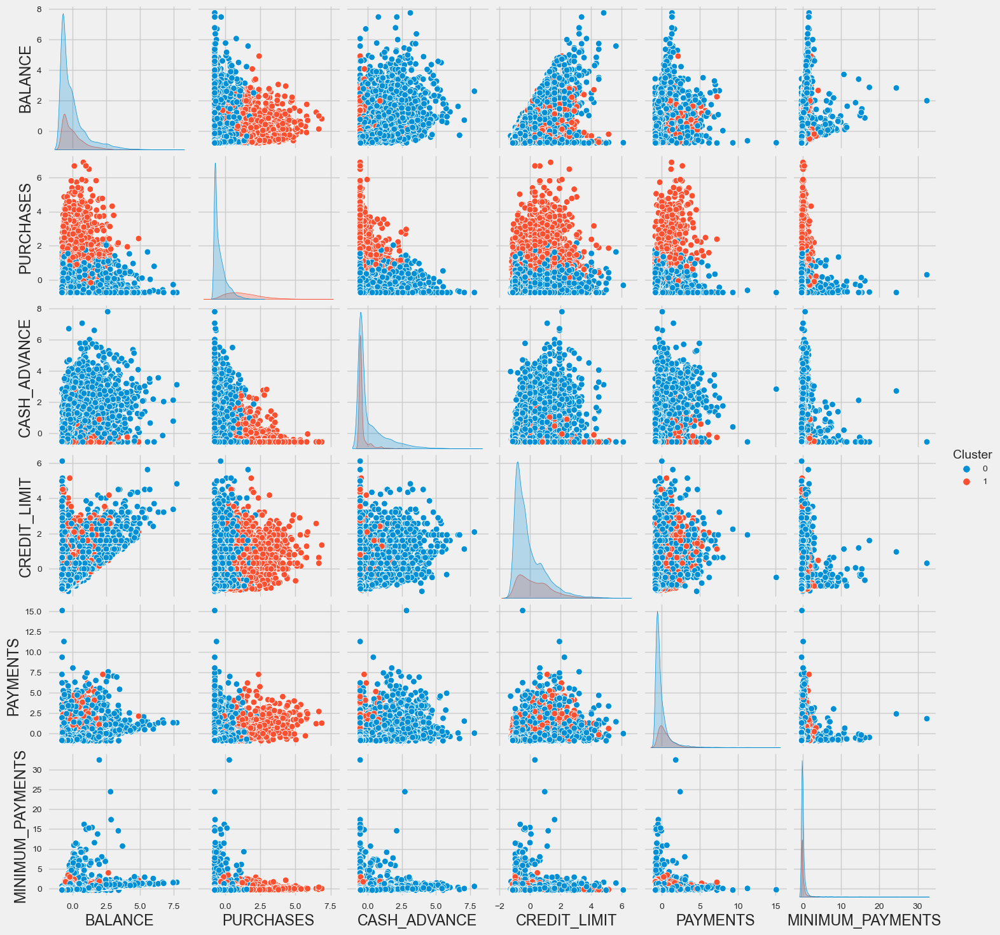

In [127]:
best_cols = ["BALANCE", "PURCHASES", "CASH_ADVANCE","CREDIT_LIMIT", "PAYMENTS", "MINIMUM_PAYMENTS",'Cluster']
sns.pairplot(df_AgglomerativeC[ best_cols ], hue="Cluster")

###  4. DBSCAN clustering algorithm
 DBSCAN stands for density-based spatial clustering of applications with noise. It's a density-based clustering algorithm.
It is able to find irregular-shaped clusters. It separates regions by areas of low-density so it can also detect outliers really well. This algorithm is better than k-means when it comes to working with oddly shaped data.

In [111]:
df_DBScan = scaled_df.copy()

In [112]:
outlier_percent = [] 

for eps in np.linspace(0.001,3,50): # check 50 values of epsilon between 0.001 and 3
    
    # Create Model
    dbscan = DBSCAN(eps=eps,min_samples=8)
    dbscan.fit(scaled_df)
   
    # Percentage of points that are outliers
    perc_outliers = 100 * np.sum(dbscan.labels_ == -1) / len(dbscan.labels_)
    outlier_percent.append(perc_outliers)

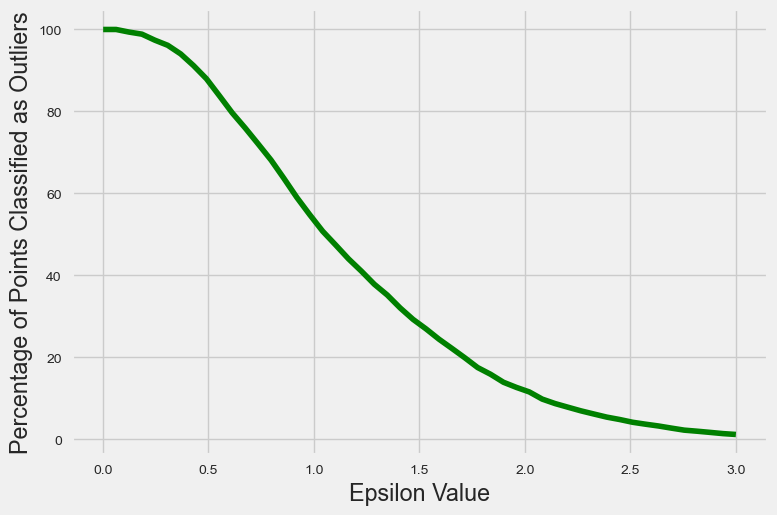

In [113]:
sns.lineplot(x=np.linspace(0.001,3,50),y=outlier_percent, color='green')
plt.ylabel("Percentage of Points Classified as Outliers")
plt.xlabel("Epsilon Value");

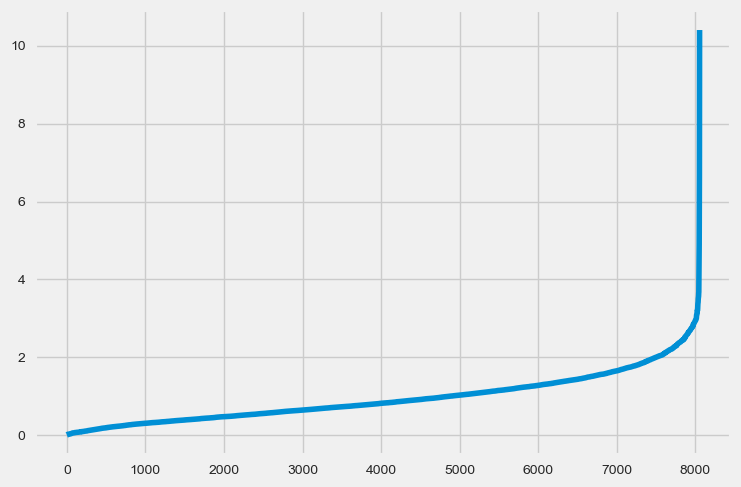

In [114]:
neigh = NearestNeighbors(n_neighbors=4)
nbrs = neigh.fit(scaled_df)
distances, indices = nbrs.kneighbors(scaled_df)
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances)

In [152]:
Eps=[]
Min_samples=[]
num_clusters = []
best_n_clusters = 2
max_sil = 0
for i in  range(2,21):
    for j in  range(1,5):
        model_db = DBSCAN(eps=j, min_samples = i, metric='euclidean')
        model_db.fit(df_DBScan)
        labels = model_db.labels_
        n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)#cluster (-1), is not exactly part of a cluster. They are simply points that do not belong to any clusters and can be "ignored" to some extent.
        num_clusters.append(n_clusters_)
        Min_samples.append(i)
        Eps.append(j)
    
        score = silhouette_score(df_DBScan,  model_db.labels_)
        silhouette_coefficients.append(score)
        if (score > max_sil) and (n_clusters_>=2):
            max_sil = score
            best_n_clusters = n_clusters_ 
            min_sample = i
            eps = j

In [156]:
dbscan = DBSCAN(eps=4,min_samples=2)
y_DBScan= dbscan.fit_predict(df_DBScan)

In [158]:
labels

array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

In [157]:
# Checking number of items in clusters and creating 'Cluster' column
df_DBScan['Cluster'] = y_DBScan
df_DBScan['Cluster'].value_counts()

 0    8043
-1       9
 1       2
Name: Cluster, dtype: int64

In [163]:
# Instantiate the DBSCAN for 2 clusters
dbscan = DBSCAN(eps=4,min_samples=2)
# Fit the DBSCAN model
dbscan.fit_predict(df_DBScan)
# Calculate Silhoutte Score
score = silhouette_score(scaled_features, dbscan.labels_, metric='euclidean')
# Print the score
print('Silhouetter Average Score: %.3f' % score)

Silhouetter Average Score: 0.577


In [164]:
describe_clusters2 = scaled_df.groupby(df_DBScan['Cluster']).mean()
describe_clusters2

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,Monthly_avg_purchase,Monthly_cash_advance
Cluster,,,,,,,,,,,,,,,,,,,
-1,1.058219,-0.216549,0.186544,-0.208248,0.612091,0.837880,0.020731,-0.107946,0.222997,-0.144378,-0.017700,3.113031,0.818953,3.494355,9.703119,-0.077197,0.265352,0.177382,0.737005
0,-0.001701,0.000110,-0.000622,0.000312,-0.001533,-0.000800,-0.000357,0.000125,-0.000664,0.000329,0.000156,-0.006390,-0.001077,-0.004121,-0.010989,0.000213,-0.000384,-0.000601,-0.000688
1,2.078395,0.531346,1.662396,-0.317795,3.411995,-0.552635,1.341012,-0.017575,1.666696,-0.673627,-0.549345,11.689582,0.644097,0.846781,0.527700,-0.508319,0.351760,1.617868,-0.548933


In [165]:
# create a dataframe of these two componenets
pca_df2 = pd.DataFrame(data = pca_components, columns = ['pca1', 'pca2'])
pca_df2.head()

,pca1,pca2
0,-0.980567,-2.147223
1,-4.075074,4.022160
2,1.488020,0.554082
3,0.292967,0.040387
4,-1.165750,-1.697506


In [166]:
# Concatenate the clusters labels to the dataframe
pca_df2 = pd.concat([pca_df2,pd.DataFrame({'cluster2':y_DBScan})], axis = 1)
pca_df2.head()

,pca1,pca2,cluster2
0,-0.980567,-2.147223,0
1,-4.075074,4.022160,0
2,1.488020,0.554082,0
3,0.292967,0.040387,0
4,-1.165750,-1.697506,0


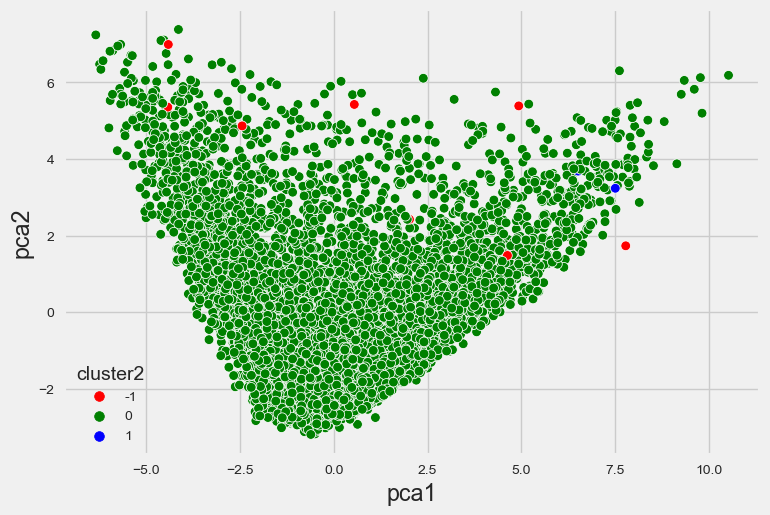

In [168]:
# Visualize the clusters in 2-axes plane
ax = sns.scatterplot(x="pca1", y="pca2", hue = "cluster2", data = pca_df2, palette =['red','green','blue'])
plt.show()

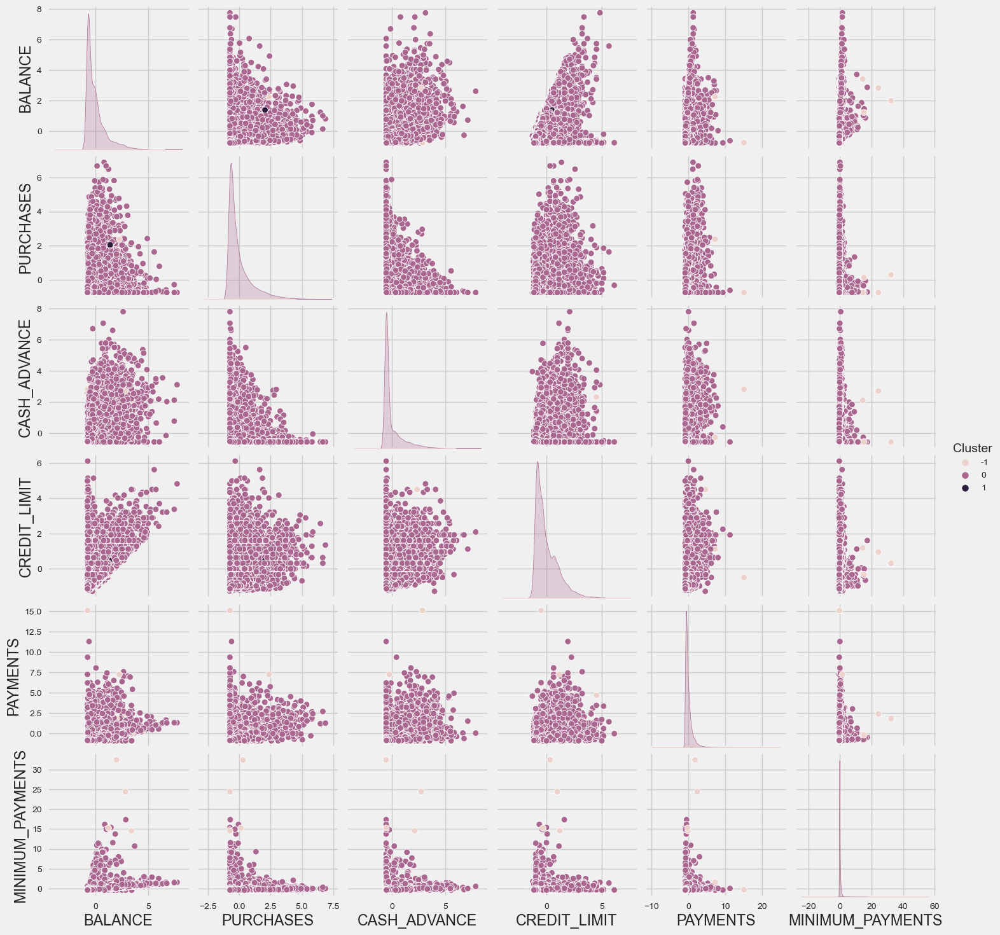

In [169]:
best_cols = ["BALANCE", "PURCHASES", "CASH_ADVANCE","CREDIT_LIMIT", "PAYMENTS", "MINIMUM_PAYMENTS",'Cluster']
sns.pairplot(df_DBScan[ best_cols ], hue="Cluster")

### 5. Gaussian Mixture Models (GMM) 
A Gaussian mixture model (GMM) attempts to find a mixture of multi-dimensional Gaussian probability distributions that best model any input dataset. In the simplest case, GMMs can be used for finding clusters in the same manner as k-means, but because GMM contains a probabilistic model under the hood, it is also possible to find probabilistic cluster assignments.

The Gaussian mixture model uses multiple Gaussian distributions to fit arbitrarily shaped data.

There are several single Gaussian models that act as hidden layers in this hybrid model. So the model calculates the probability that a data point belongs to a specific Gaussian distribution and that's the cluster it will fall under.

In [171]:
df_GMM = scaled_df.copy()

In [174]:
def evaluate_metrics(df1,min_n_components=2, max_n_components=11, rand_state=1):

    silhouette = []
    ch_score = []
    db_score = []
    for k in range(min_n_components, max_n_components):#this range is optional
          
        gmm = GaussianMixture(n_components=k, random_state=1 )   #each gaussian in your mixture is one component 
        y_GMM = gmm.fit_predict(df_GMM)
   
        silhouette.append(silhouette_score(scaled_features, y_GMM))
        ch_score.append(calinski_harabasz_score(scaled_features, y_GMM))
        db_score.append(davies_bouldin_score(scaled_features, y_GMM))        

    
    fig, ax = plt.subplots(2, 2, figsize=(15, 10))
    ax[0][0].plot(range(min_n_components, max_n_components), silhouette, '-x', linewidth=2)
    ax[0][0].set_xlabel('No. of clusters')
    ax[0][0].set_ylabel('Silhouette Score')
    
    ax[0][1].plot(range(min_n_components, max_n_components), ch_score, '-x', linewidth=2)
    ax[0][1].set_xlabel('No. of clusters')
    ax[0][1].set_ylabel('Calinski Harabasz Score')
    
    ax[1][0].plot(range(min_n_components, max_n_components), db_score, '-x', linewidth=2)
    ax[1][0].set_xlabel('No. of clusters')
    ax[1][0].set_ylabel('Davies Bouldin Score')
    fig.suptitle('Metrics to evaluate the number of clusters')
    plt.show()

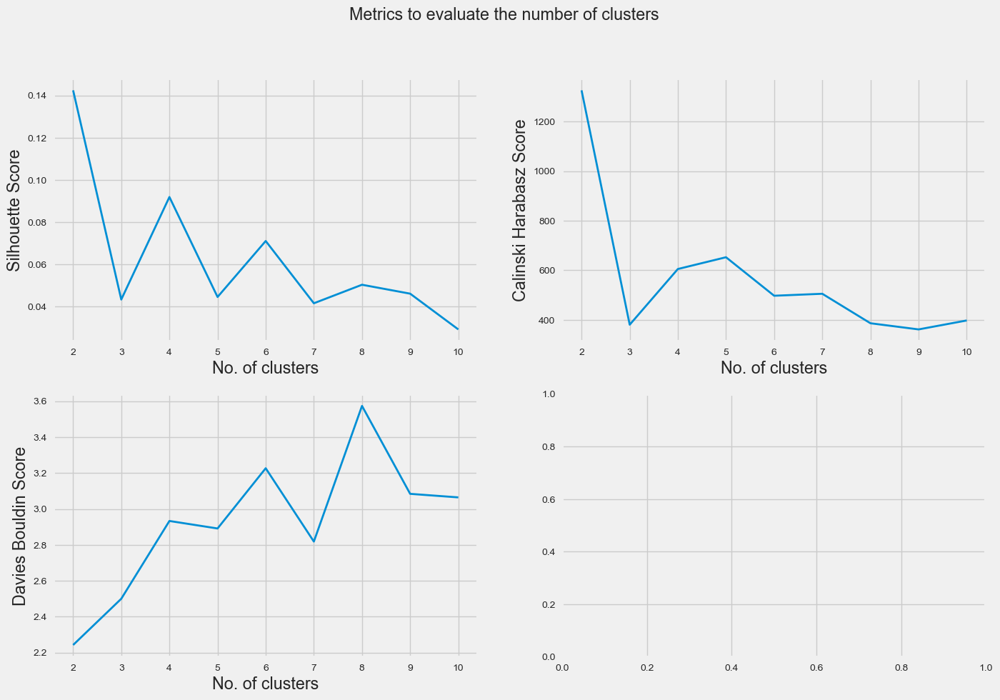

In [175]:
evaluate_metrics(scaled_features, min_n_components=2, max_n_components=11, rand_state=1)

In [176]:
gmm = GaussianMixture(n_components=2)
y_GMM = gmm.fit_predict(df_GMM)

In [177]:
# Checking number of items in clusters and creating 'Cluster' column
df_GMM['Cluster'] = y_GMM
df_GMM['Cluster'].value_counts()

0    4181
1    3873
Name: Cluster, dtype: int64

In [179]:
# Instantiate the GMM for 2 clusters
gmm = GaussianMixture(n_components=2)
# Fit the GMM model
gmm.fit_predict(df_GMM)
# Calculate Silhoutte Score
score = silhouette_score(scaled_features, y_GMM, metric='euclidean')
# Print the score
print('Silhouetter Average Score: %.3f' % score)

Silhouetter Average Score: 0.142


In [180]:
describe_clusters3 = scaled_df.groupby(df_GMM['Cluster']).mean()
describe_clusters3

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,Monthly_avg_purchase,Monthly_cash_advance
Cluster,,,,,,,,,,,,,,,,,,,
0,-0.417822,-0.178978,0.286273,0.189691,0.262791,-0.552557,0.456328,0.206146,0.371429,-0.673058,-0.549033,0.267528,0.013331,-0.151087,-0.217437,0.336116,0.061038,0.288904,-0.548860
1,0.451050,0.193211,-0.309038,-0.204776,-0.283690,0.596499,-0.492617,-0.222539,-0.400967,0.726583,0.592695,-0.288803,-0.014391,0.163102,0.234728,-0.362846,-0.065892,-0.311880,0.592509


In [181]:
# create a dataframe of these two componenets
pca_df3 = pd.DataFrame(data = pca_components, columns = ['pca1', 'pca2'])
pca_df3.head()

,pca1,pca2
0,-0.980567,-2.147223
1,-4.075074,4.022160
2,1.488020,0.554082
3,0.292967,0.040387
4,-1.165750,-1.697506


In [182]:
# Concatenate the clusters labels to the dataframe
pca_df3 = pd.concat([pca_df3,pd.DataFrame({'cluster3':y_GMM})], axis = 1)
pca_df3.head()

,pca1,pca2,cluster3
0,-0.980567,-2.147223,0
1,-4.075074,4.022160,1
2,1.488020,0.554082,0
3,0.292967,0.040387,1
4,-1.165750,-1.697506,0


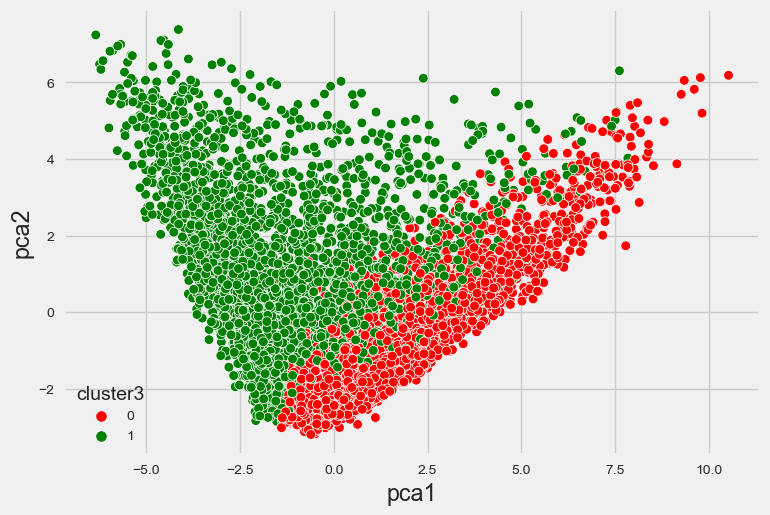

In [183]:
# Visualize the clusters in 2-axes plane
ax = sns.scatterplot(x="pca1", y="pca2", hue = "cluster3", data = pca_df3, palette =['red','green'])
plt.show()

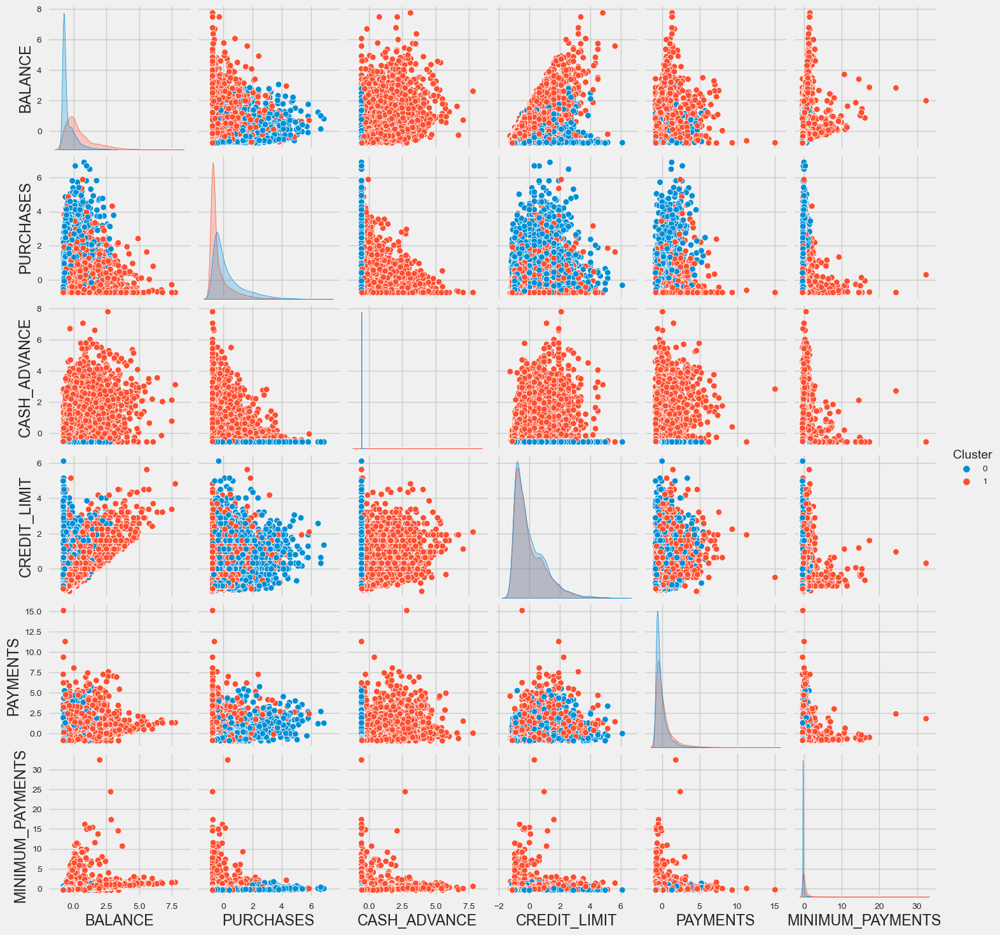

In [184]:
best_cols = ["BALANCE", "PURCHASES", "CASH_ADVANCE","CREDIT_LIMIT", "PAYMENTS", "MINIMUM_PAYMENTS",'Cluster']
sns.pairplot(df_GMM[ best_cols ], hue="Cluster")

### Conclusion :
It seems that for this data set, k_Means performed better and was able to cluster better.
Using this algorithm, customers are divided into three groups as follows:

## cluster0: 
low balance, low purchase, low cash advance, low payment and low minimum payment, medium credit cart and medium purches frequency.

## cluster1:
low purchase, medium balance,cash advance,payment and minimum payment, high credit cart

## cluster2: 
low cash advance,payment, medium balance,purchase,payment, high credit cart,  purchase frequency and  purchase installment freguency.   

DB scan for this dataset seems to have had no good results.